In [0]:
%pip install tzwhere
%pip install geopandas
%pip install pyspark_dist_explore

Python interpreter will be restarted.
Python interpreter will be restarted.
Python interpreter will be restarted.
Python interpreter will be restarted.
Python interpreter will be restarted.
Python interpreter will be restarted.


In [0]:
from pyspark.sql.functions import *
from pyspark.sql import *
from pyspark.sql.types import IntegerType, StringType
from pyspark.ml.regression import (
    LinearRegression,
    RandomForestRegressor,
    DecisionTreeRegressor,
    GBTRegressor,
)
from pyspark.ml.classification import (
    DecisionTreeClassifier,
    RandomForestClassifier,
    GBTClassifier,
)
from pyspark.ml.feature import (
    VectorAssembler,
    StandardScaler,
    MinMaxScaler,
    StringIndexer,
    OneHotEncoder,
)
from pyspark.ml.stat import Correlation
from pyspark.ml.tuning import ParamGridBuilder
from pyspark.ml.evaluation import (
    RegressionEvaluator,
    MulticlassClassificationEvaluator,
    BinaryClassificationEvaluator,
)
from pyspark.ml import Pipeline
import numpy as np
import plotly
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
import datetime as dt
import itertools
import re
import pytz

# from tzwhere import tzwhere
# import geopandas as gpd
# import pyspark_dist_explore as psgraph
BACKGROUND = "black"
FOREGROUND = "#73F9CB"

In [0]:
display(dbutils.fs.ls(f"/mnt/mids-w261-joined/"))

path,name,size,modificationTime
dbfs:/mnt/mids-w261-joined/YEAR=2015/,YEAR=2015/,0,1658437611000
dbfs:/mnt/mids-w261-joined/YEAR=2016/,YEAR=2016/,0,1658437611000
dbfs:/mnt/mids-w261-joined/YEAR=2017/,YEAR=2017/,0,1658437611000
dbfs:/mnt/mids-w261-joined/YEAR=2018/,YEAR=2018/,0,1658437611000
dbfs:/mnt/mids-w261-joined/YEAR=2019/,YEAR=2019/,0,1658437611000
dbfs:/mnt/mids-w261-joined/YEAR=2020/,YEAR=2020/,0,1658437611000
dbfs:/mnt/mids-w261-joined/YEAR=2021/,YEAR=2021/,0,1658437611000
dbfs:/mnt/mids-w261-joined/_SUCCESS,_SUCCESS,0,1658437611000
dbfs:/mnt/mids-w261-joined/_committed_1995221853517722120,_committed_1995221853517722120,38,1658437611000


### Load the Raw Data

Initially the joined data provided by the instructors has the following sizes:
  * joined data: 42271633 rows, 168 columns

In [0]:
data_BASE_DIR = "dbfs:/mnt/mids-w261-joined/"

df_2015 = spark.read.parquet(f"{data_BASE_DIR}YEAR=2015/")
df_2016 = spark.read.parquet(f"{data_BASE_DIR}YEAR=2016/")
df_2017 = spark.read.parquet(f"{data_BASE_DIR}YEAR=2017/")
df_2018 = spark.read.parquet(f"{data_BASE_DIR}YEAR=2018/")
df_2019 = spark.read.parquet(f"{data_BASE_DIR}YEAR=2019/")
df_2020 = spark.read.parquet(f"{data_BASE_DIR}YEAR=2020/")
df_2021 = spark.read.parquet(f"{data_BASE_DIR}YEAR=2021/")

data = df_2015.union(df_2016)
data = data.union(df_2017)
data = data.union(df_2018)
data = data.union(df_2019)
data = data.union(df_2020)
data = data.union(df_2021)

In [0]:
data_count = data.count()
number_of_columns = len(data.columns)
print(
    f"The total number of rows is {data_count} and total number of columns is {number_of_columns}"
)

The total number of rows is 42271633 and total number of columns is 168


In [0]:
# Let's ensure there are no duplicates
data = data.dropDuplicates()
# dbutils.data.summarize(data)

We have a couple of columns with missing values. let's drop the columns that have more than 40% null values.

In [0]:
# Let's go ahead to drop columns with missing data that are above 40%.

data = data.drop(
    "CARRIER_DELAY",
    "WEATHER_DELAY",
    "NAS_DELAY",
    "SECURITY_DELAY",
    "LATE_AIRCRAFT_DELAY",
    "FIRST_DEP_TIME",
    "TOTAL_ADD_GTIME",
    "LONGEST_ADD_GTIME",
    "origin_weather_Avg_HourlyPressureChange",
    "origin_weather_Avg_HourlyWindGustSpeed",
    "dest_weather_Avg_HourlyPressureChange",
    "dest_weather_Avg_HourlyWindGustSpeed",
    "CANCELLATION_CODE",
)

# We also have a couple of columns with about 3% of missing data. Since this is small number of NA we can just drop the NA.
data = data.na.drop()

# Let us again check summary to see the drops took effect.
# dbutils.data.summarize(data)

### Blob Storage 
<div>
  <table>
    <tr> <td><img src="https://media3.giphy.com/media/y2WVrfoLeD8yMaNxr5/200w.gif?cid=6c09b952y454jw98c0kz8dej0pzbgme3klo72toxv1ycwut7&rid=200w.gif&ct=g" width=150%></td> <td>The following cell will allow users to read and write from and Azure Binary Large Object (BLOB) cloud storage container that was configured to be accessible to all team members. The 'blob_url' path generated from this code is used subsequently for caching the results of slow operations like the joining of the full weather and flights data set and saving the cross validation time series splits.</td>   
      
  </table>
</div>

In [0]:
blob_container = (
    "###"  # The name of your container created in https://portal.azure.com
)
storage_account = "###"  # The name of your Storage account created in https://portal.azure.com
secret_scope = "###"  # The name of the scope created in your local computer using the Databricks CLI
secret_key = "###"  # saskey The name of the secret key created in your local computer using the Databricks CLI
blob_url = f"wasbs://{blob_container}@{storage_account}.blob.core.windows.net"
mount_path = "/mnt/mids-w261"

spark.conf.set(
    f"fs.azure.sas.{blob_container}.{storage_account}.blob.core.windows.net",
    dbutils.secrets.get(scope=secret_scope, key=secret_key),
)

In [0]:
# Let's check numner of rows and columns after removing duplicates and null values
data_count = data.count()
number_of_columns = len(data.columns)
print(
    f"The total number of rows is {data_count} and total number of columns is {number_of_columns}"
)

The total number of rows is 36976385 and total number of columns is 155


In [0]:
display(data)

_utc_dept_ts,_utc_dept_minus2_ts,_utc_dept_actual_ts,_utc_arr_ts,_utc_arr_actual_ts,_dep_time_str,_local_dept_ts,_local_dept_minus2_ts,_local_dept_actual_ts,_local_at_src_airport_arr_ts,_local_at_src_airport_arr_actual_ts,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,origin_airport_iata,origin_airport_tz,origin_airport_type,origin_airport_elevation,origin_airport_iso_country,origin_airport_iso_region,origin_airport_ws_station_id,dest_airport_iata,dest_airport_tz,dest_airport_type,dest_airport_elevation,dest_airport_iso_country,dest_airport_iso_region,dest_airport_ws_station_id,origin_weather_Station,origin_weather_Datehour,origin_weather_Avg_Elevation,origin_weather_Avg_HourlyAltimeterSetting,origin_weather_Avg_HourlyDewPointTemperature,origin_weather_Avg_HourlyDryBulbTemperature,origin_weather_Avg_HourlyRelativeHumidity,origin_weather_Avg_HourlySeaLevelPressure,origin_weather_Avg_HourlyStationPressure,origin_weather_Avg_HourlyVisibility,origin_weather_Avg_HourlyWetBulbTemperature,origin_weather_Avg_HourlyWindDirection,origin_weather_Avg_HourlyWindSpeed,origin_weather_Avg_Precip_Double,origin_weather_Trace_Rain,origin_weather_NonZero_Rain,origin_weather_HourlyPressureTendency_Increasing,origin_weather_HourlyPressureTendency_Decreasing,origin_weather_HourlyPressureTendency_Constant,origin_weather_Calm_Winds,origin_weather_Sky_Conditions_CLR,origin_weather_Sky_Conditions_FEW,origin_weather_Sky_Conditions_SCT,origin_weather_Sky_Conditions_BKN,origin_weather_Sky_Conditions_OVC,origin_weather_Sky_Conditions_VV,origin_weather_Present_Weather_Drizzle,origin_weather_Present_Weather_Rain,origin_weather_Present_Weather_Snow,origin_weather_Present_Weather_SnowGrains,origin_weather_Present_Weather_IceCrystals,origin_weather_Present_Weather_Hail,origin_weather_Present_Weather_Mist,origin_weather_Present_Weather_Fog,origin_weather_Present_Weather_Smoke,origin_weather_Present_Weather_Dust,origin_weather_Present_Weather_Haze,origin_weather_Present_Weather_Storm,dest_weather_Station,dest_weather_Datehour,dest_weather_Avg_Elevation,dest_weather_Avg_HourlyAltimeterSetting,dest_weather_Avg_HourlyDewPointTemperature,dest_weather_Avg_HourlyDryBulbTemperature,dest_weather_Avg_HourlyRelativeHumidity,dest_weather_Avg_HourlySeaLevelPressure,dest_weather_Avg_HourlyStationPressure,dest_weather_Avg_HourlyVisibility,dest_weather_Avg_HourlyWetBulbTemperature,dest_weather_Avg_HourlyWindDirection,dest_weather_Avg_HourlyWindSpeed,dest_weather_Avg_Precip_Double,dest_weather_Trace_Rain,dest_weather_NonZero_Rain,dest_weather_HourlyPressureTendency_Increasing,dest_weather_HourlyPressureTendency_Decreasing,dest_weather_HourlyPressureTendency_Constant,dest_weather_Calm_Winds,dest_weather_Sky_Conditions_CLR,dest_weather_Sky_Conditions_FEW,dest_weather_Sky_Conditions_SCT,dest_weather_Sky_Conditions_BKN,dest_weather_Sky_Conditions_OVC,dest_weather_Sky_Conditions_VV,dest_weather_Present_Weather_Drizzle,dest_weather_Present_Weather_Rain,dest_weather_Present_Weather_Snow,dest_weather_Present_Weather_SnowGrains,dest_weather_Present_Weather_IceCrystals,dest_weather_Present_Weather_Hail,dest_weather_Present_Weather_Mist,dest_weather_Present_Weather_Fog,dest_weather_Present_Weather_Smoke,dest_weather_Present_Weather_Dust,dest_weather_Present_Weather_Haze,dest_weather_Present_Weather_Storm
2015-10-10T16:00:00.000+0000,2015-10-1

**Airports Data ✈️**

The time in the airports data set is expressed in the local time of the origin airport through an integer field called 'CRS_DEP_TIME' where CRS refers to 'Computer Reservation System'. In the weather data set we plan to join to later, the weather data sample time is recorded in Universal Time Code which is timezone agnostic. In order to enable the subsequent join of these tables we performed the following operations in the cell below. In addition, we found that the representation of feature "FL_DATE" for 2020 and 2021 are different from the rest of the years. 2020 and 2021 are represented in this pattern "yyyy-mm-dd 00:00:00" while others are represented as "yyyy-mm-dd". So to fix this problem we extracted the first 10 characters so that the FL_DATE feature has a uniform pattern ("yyyy-mm-dd") for all the years.
* Remove and duplicate flight/time rows 
* Join the airlines dataframe to the stations data_frame on airport name to allow inclusion of the timezone column we created above
* Convert the integer departure time to a string and concatenate with the flight date to create a time stamp in 'yyyy-MM-dd HHmm' format
* Substract 2 hours from the converted scheduled departure time stamp to enforce the >2hrs before departure data constraint 
* Truncate the time stamp to the nearest hour to allow a one-to-one link to the weather data as a new columne '2HR_PRE_DEP'

The join of weather and stations resulted in the loss of a significant number of flight data points which may be for airports which do not have corresponding weather stations. In this case the better approach would be to join on a nearest station location instead of only stations with 0 distance to the nearby airport. We may attemp this more nuanced joininig strategy in the next phase of the project.

In [0]:
# Assign a string label based on delay group to bucket the flight delays by extremity and integrate the 'cancelled' state to create a unique set of classes for the classifcation task
# FROM 0 TO 16


def delay_group(dep_delay_group, cancelled):
    departure_delay_group_dictionary = {
        0: "<-15",
        1: "-15 to 0",
        2: "0 to 14",
        3: "15 to 29",
        4: "30 to 44",
        5: "45 to 59",
        6: "60 to 74",
        7: "75 to 89",
        8: "90 to 104",
        9: "105 to 119",
        10: "120 to 134",
        11: "135 to 149",
        12: "150 to 164",
        13: "65 to 179",
        14: ">= 180",
        15: "Cancelled",
        16: "Unknown",
    }
    return departure_delay_group_dictionary[dep_delay_group]


def delay_group_num(cancelled, dep_delay_group):
    if dep_delay_group >= 0:
        if cancelled > 0:
            return 15
        else:
            return dep_delay_group
    else:
        return 1


delay_group_num = udf(delay_group_num, IntegerType())
delay_group = udf(delay_group, StringType())

data = data.withColumn(
    "DEP_DELAY_GROUP", delay_group_num(col("CANCELLED"), col("DEP_DELAY_GROUP"))
).withColumn("DELAY_LABEL", delay_group(col("DEP_DELAY_GROUP"), col("CANCELLED")))

data.createOrReplaceTempView("data")
delay_label_counts = spark.sql(
    "select DEP_DELAY_GROUP, DELAY_LABEL, count(TAIL_NUM) as flight_count from data group by DELAY_LABEL, DEP_DELAY_GROUP"
).toPandas()

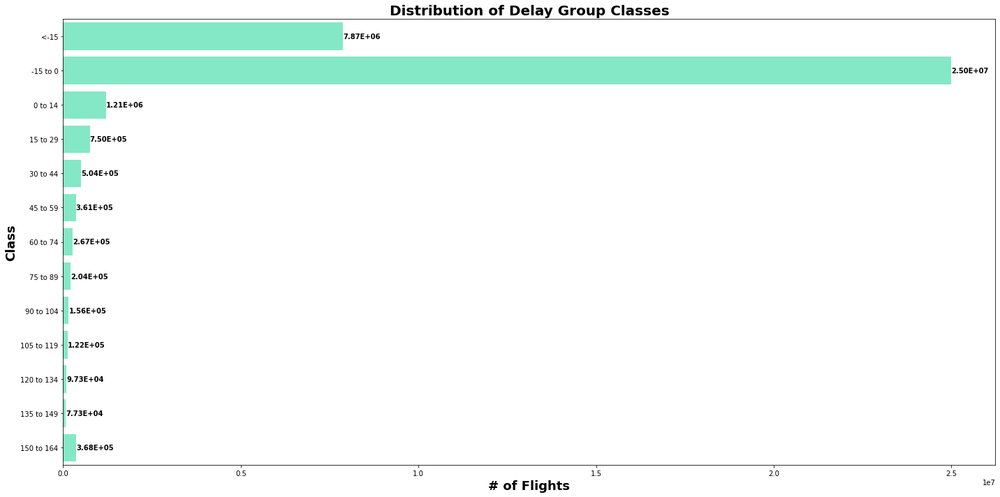

In [0]:
# Plot the distribution of flights in the different delay group classes
fig, ax = plt.subplots(figsize=(20, 10))
colors = {0.0: BACKGROUND, 1.0: FOREGROUND}
delay_label_counts.sort_values(by="DEP_DELAY_GROUP", ascending=True, inplace=True)
sns.barplot(
    data=delay_label_counts, y="DELAY_LABEL", x="flight_count", color=FOREGROUND
)
ax.bar_label(ax.containers[0], fmt="%.2E", fontweight="bold")
ax.set_title(
    "Distribution of Delay Group Classes",
    fontdict={"fontsize": 20, "fontweight": "bold"},
)
ax.set_xlabel("# of Flights", fontdict={"fontsize": 18, "fontweight": "bold"})
ax.set_ylabel("Class", fontdict={"fontsize": 18, "fontweight": "bold"})
fig.tight_layout()

### Checking the Class Imbalance for Delayed Flights

As shown in the bar chart below, the flight records without delays are 4.5 times more than those with delays. This means that generally flights are on time, and the target variable 'DEP_DEL15' is significantly disproportionate between being delayed or not. In order to reduce bias when training our model, we will downsample the joined data later in this report.

Out[11]: [Text(0, 0, 'Not-Delayed'), Text(1, 0, 'Delayed')]

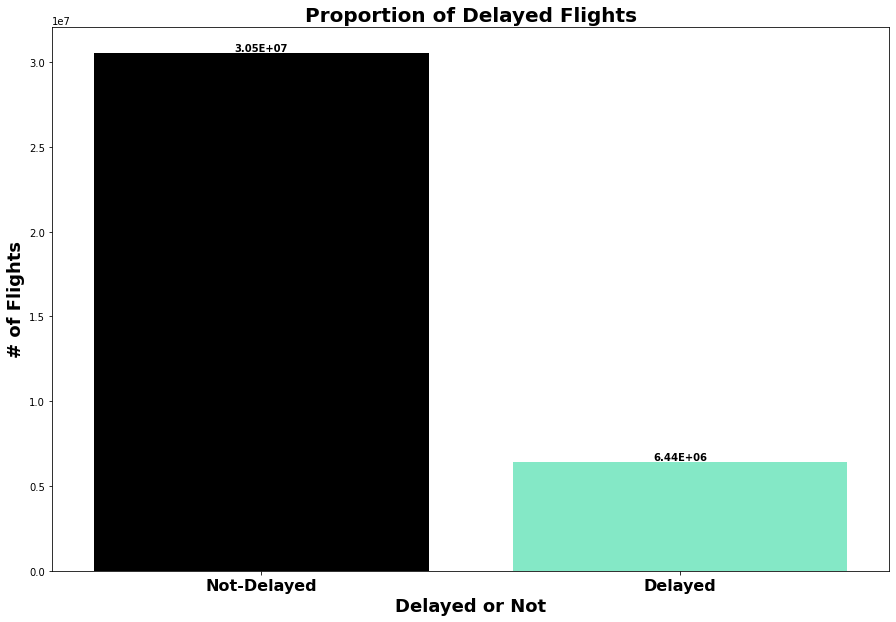

In [0]:
delay_count = spark.sql(
    "select DEP_DEL15 as delayed, count(DEP_DEL15) as counts from data group by DEP_DEL15 "
).toPandas()
fig, ax = plt.subplots(figsize=(15, 10))
colors = {0.0: BACKGROUND, 1.0: FOREGROUND}
sns.barplot(data=delay_count, x="delayed", y="counts", palette=colors)
ax.bar_label(ax.containers[0], fmt="%.2E", fontweight="bold")
ax.set_title(
    "Proportion of Delayed Flights", fontdict={"fontsize": 20, "fontweight": "bold"}
)
ax.set_xlabel("Delayed or Not", fontdict={"fontsize": 18, "fontweight": "bold"})
ax.set_ylabel("# of Flights", fontdict={"fontsize": 18, "fontweight": "bold"})
ax.set_xticklabels(
    ["Not-Delayed", "Delayed"], fontdict={"fontsize": 16, "fontweight": "bold"}
)

### Feature Engineering ###

The following graphical summary was extracted from the [FAA](https://www.faa.gov/nextgen/programs/weather/faq) and was used in combination with our own EDA of the flight and weather data sets to select and generate new model features. In addition to the base weather numeric variables we have created the following additional features below to operationalize the concepts described in the FAA summary:
* Volume
    - *volume_sigma*: # of sigma and direction away from the average # of scheduled departures for a given airport. This reflects how 'busy' the airport is that day compared to normal. 
    - *traffic*: The total daily scheduled depatures for a given airport. This unscaled version of the volume metric allows comparison of business across airports. 
    - *inbound_delay* The # of minutes the departure of the last inbound flight with the same tail number was delayed.
* Weather
    - *thunderstorm, heavy_fog, hail, dust_storm, high_winds, freezing_rain, tornado*: These features were extracted from the PresentWeatherType variable and one-hot-encoded directly. 
    
<img src="https://github.com/stackoverthrow/261section7group2/blob/main/FAA%20SLIDE.001.jpeg?raw=true" width=50%>

**Airport Daily Volume 🛫 🛫 🛫**

According to the FAA the volume of flights at a given airport is a key factor impacting the likelihood of flight delays due to gate and taxi-way traffic overload. Since the scheduled flights for the next day could be known before the two hour pre-arrival interval despite the data including flights after the departure time of a given flight on that day, it is still a valid feature to include in the 2-hour pre-depature predictive model. To operationalize the volume metric for each airport the following computations are performed below: 
* Count the number of scheduled departures for each airport 'origin' on each depature date in the flights data set
* Calculate the overall average number of flights and the standard deviation for each airport in the 'airport_volume_stats' view 
* Join the day acounts and flight statistics to the main flights data dataframe. 
* Create a new column in the flights data called 'volume_sigma' reflecting how many standard deviations the count for that day is away from the mean for the airport. 

The idea with this metric is that total count for the day and airport is not an adequate metric on its own given the significant variation in the expected departures for a given airport (Atlanta GA vs. Sioux Falls SD for example). The 'volume_sigma' metric is normalized regardless of the airport and will be positive and greater than 1 or so on very busy days and negative and less than 1 on slow days.

In [0]:
# Count the number of unique scheduled departure times from each origin airport on a daily basis to understand the flight 'volume' distribution
data.createOrReplaceTempView("data")
air_traffic_by_day = spark.sql(
    """SELECT origin as origin_traffic, fl_date as traffic_date, count(tail_num, crs_dep_time) AS traffic 
                                  FROM data GROUP BY origin_traffic, traffic_date ORDER BY traffic_date, traffic DESC"""
)

# Register air_traffic by data as a new view to use SQL and then compute the overall average and standard deviation in the count by each airport to get a 'range' of volume variation
air_traffic_by_day.createOrReplaceTempView("air_traffic_by_day")
airport_volume_stats = spark.sql(
    """SELECT origin_traffic as volume_origin, avg(traffic) as average_daily_departures, std(traffic) as sigma_daily_departures
                                    FROM air_traffic_by_day GROUP BY origin_traffic ORDER BY average_daily_departures DESC"""
)
airport_volume_df = airport_volume_stats.toPandas()

# First join the overall stats to the corresponding airport then calculate the number of sigmas away from the average each days count is
air_traffic_by_day = (
    air_traffic_by_day.join(
        airport_volume_stats,
        airport_volume_stats["volume_origin"] == air_traffic_by_day["origin_traffic"],
        "left",
    )
    .withColumn(
        "volume_sigma",
        (col("traffic") - col("average_daily_departures"))
        / col("sigma_daily_departures"),
    )
    .withColumn(
        "volume_sigma",
        when(col("volume_sigma").isNull(), 0).otherwise(col("volume_sigma")),
    )
    .select("origin_traffic", "traffic_date", "traffic", "volume_sigma")
)

# Then join the air traffic_by_day feature dataframe to the main data dataframe
data_traffic = data.join(
    air_traffic_by_day,
    (air_traffic_by_day["traffic_date"] == data["fl_date"])
    & (air_traffic_by_day["origin_traffic"] == data["origin"]),
    "left",
).cache()
data_traffic.createOrReplaceTempView("data_traffic")
display(data_traffic)

_utc_dept_ts,_utc_dept_minus2_ts,_utc_dept_actual_ts,_utc_arr_ts,_utc_arr_actual_ts,_dep_time_str,_local_dept_ts,_local_dept_minus2_ts,_local_dept_actual_ts,_local_at_src_airport_arr_ts,_local_at_src_airport_arr_actual_ts,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,origin_airport_iata,origin_airport_tz,origin_airport_type,origin_airport_elevation,origin_airport_iso_country,origin_airport_iso_region,origin_airport_ws_station_id,dest_airport_iata,dest_airport_tz,dest_airport_type,dest_airport_elevation,dest_airport_iso_country,dest_airport_iso_region,dest_airport_ws_station_id,origin_weather_Station,origin_weather_Datehour,origin_weather_Avg_Elevation,origin_weather_Avg_HourlyAltimeterSetting,origin_weather_Avg_HourlyDewPointTemperature,origin_weather_Avg_HourlyDryBulbTemperature,origin_weather_Avg_HourlyRelativeHumidity,origin_weather_Avg_HourlySeaLevelPressure,origin_weather_Avg_HourlyStationPressure,origin_weather_Avg_HourlyVisibility,origin_weather_Avg_HourlyWetBulbTemperature,origin_weather_Avg_HourlyWindDirection,origin_weather_Avg_HourlyWindSpeed,origin_weather_Avg_Precip_Double,origin_weather_Trace_Rain,origin_weather_NonZero_Rain,origin_weather_HourlyPressureTendency_Increasing,origin_weather_HourlyPressureTendency_Decreasing,origin_weather_HourlyPressureTendency_Constant,origin_weather_Calm_Winds,origin_weather_Sky_Conditions_CLR,origin_weather_Sky_Conditions_FEW,origin_weather_Sky_Conditions_SCT,origin_weather_Sky_Conditions_BKN,origin_weather_Sky_Conditions_OVC,origin_weather_Sky_Conditions_VV,origin_weather_Present_Weather_Drizzle,origin_weather_Present_Weather_Rain,origin_weather_Present_Weather_Snow,origin_weather_Present_Weather_SnowGrains,origin_weather_Present_Weather_IceCrystals,origin_weather_Present_Weather_Hail,origin_weather_Present_Weather_Mist,origin_weather_Present_Weather_Fog,origin_weather_Present_Weather_Smoke,origin_weather_Present_Weather_Dust,origin_weather_Present_Weather_Haze,origin_weather_Present_Weather_Storm,dest_weather_Station,dest_weather_Datehour,dest_weather_Avg_Elevation,dest_weather_Avg_HourlyAltimeterSetting,dest_weather_Avg_HourlyDewPointTemperature,dest_weather_Avg_HourlyDryBulbTemperature,dest_weather_Avg_HourlyRelativeHumidity,dest_weather_Avg_HourlySeaLevelPressure,dest_weather_Avg_HourlyStationPressure,dest_weather_Avg_HourlyVisibility,dest_weather_Avg_HourlyWetBulbTemperature,dest_weather_Avg_HourlyWindDirection,dest_weather_Avg_HourlyWindSpeed,dest_weather_Avg_Precip_Double,dest_weather_Trace_Rain,dest_weather_NonZero_Rain,dest_weather_HourlyPressureTendency_Increasing,dest_weather_HourlyPressureTendency_Decreasing,dest_weather_HourlyPressureTendency_Constant,dest_weather_Calm_Winds,dest_weather_Sky_Conditions_CLR,dest_weather_Sky_Conditions_FEW,dest_weather_Sky_Conditions_SCT,dest_weather_Sky_Conditions_BKN,dest_weather_Sky_Conditions_OVC,dest_weather_Sky_Conditions_VV,dest_weather_Present_Weather_Drizzle,dest_weather_Present_Weather_Rain,dest_weather_Present_Weather_Snow,dest_weather_Present_Weather_SnowGrains,dest_weather_Present_Weather_IceCrystals,dest_weather_Present_Weather_Hail,dest_weather_Present_Weather_Mist,dest_weather_Present_Weather_Fog,dest_weather_Present_Weather_Smoke,dest_weather_Present_Weather_Dust,dest_weather_Present_Weather_Haze,dest_weather_Present_Weather_Storm,DELAY_LABEL,origin_traffic,traffic_dat

Out[13]: Text(0.5, 0, 'Daily Departures')

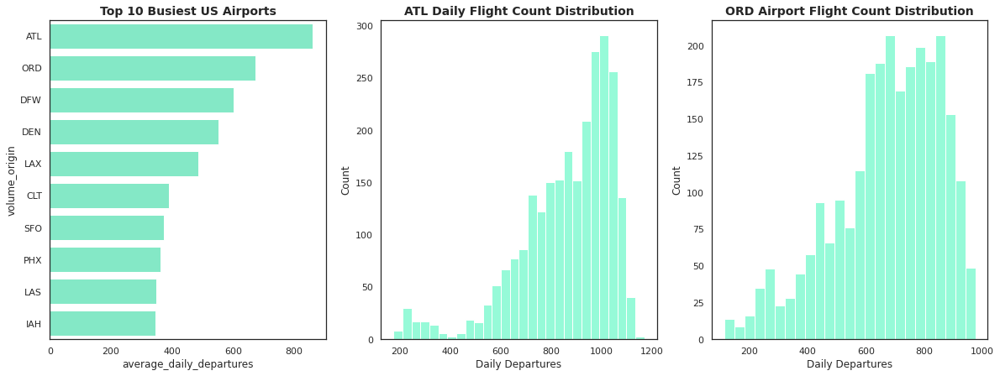

In [0]:
# Get a quick look at the distribution of flight volume for the top airports in the USA
# Colors = #73F9CB
sns.set(style="white")
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 7))
sns.barplot(
    data=airport_volume_df.head(10),
    y="volume_origin",
    x="average_daily_departures",
    color="#73F9CB",
    ax=ax[0],
)
ax[0].set_title(
    "Top 10 Busiest US Airports", fontdict={"fontsize": 14, "fontweight": "bold"}
)
atl_traffic = spark.sql(
    "SELECT * FROM air_traffic_by_day WHERE origin_traffic == 'ATL'"
).toPandas()
ord_traffic = spark.sql(
    "SELECT * FROM air_traffic_by_day WHERE origin_traffic == 'ORD'"
).toPandas()
atl_hist = sns.histplot(data=atl_traffic, x="traffic", color="#73F9CB", ax=ax[1])
ax[1].set_title(
    "ATL Daily Flight Count Distribution",
    fontdict={"fontsize": 14, "fontweight": "bold"},
)
ax[1].set_xlabel("Daily Departures")
ord_hist = sns.histplot(data=ord_traffic, x="traffic", color="#73F9CB", ax=ax[2])
ax[2].set_title(
    "ORD Airport Flight Count Distribution",
    fontdict={"fontsize": 14, "fontweight": "bold"},
)
ax[2].set_xlabel("Daily Departures")

**# of Delays & Cancellations at Origin Aiport in 2 Hour Window Pre-Departure time**

While we may not know for sure if an upcoming flight is delayed, it is reasonable to assume that if there are other flights being delayed or cancelled at the airport shortly before the 2 hour pre-departure time of the flight of interest then it is more likely that other flights are going to be delayed. Below the flights data is partitioned by the origin airport name, then sorted by scheduled 2-hour pre-departure time '_utc_dept_minus2_ts'. The number of delays in a window 4 hours before each '_utc_dept_minus2_ts' time is stored as 'delays_last_4_hrs'.

In [0]:
# Window the data frame around a sorted partition of flights data in 4 hour increments to count how many flights were delayed at the airport so far in a specified interval before the
flight_traffic_delays = spark.sql(
    """SELECT *, sum(dep_del15 + cancelled) OVER (
        PARTITION BY origin 
        ORDER BY _utc_dept_minus2_ts  
        RANGE BETWEEN INTERVAL 4 HOURS PRECEDING AND CURRENT ROW
     ) AS delays_last_4_hrs FROM data_traffic"""
).withColumn(
    "delays_last_4_hrs",
    when(col("delays_last_4_hrs").isNull(), 0).otherwise(col("delays_last_4_hrs")),
)
display(
    flight_traffic_delays.select("origin", "_utc_dept_minus2_ts", "delays_last_4_hrs")
)
flight_traffic_delays.createOrReplaceTempView("flight_traffic_delays")

delays_last_4hrs = spark.sql(
    "SELECT origin, count(_utc_dept_minus2_ts) FROM flight_traffic_delays GROUP BY origin"
)
display(delays_last_4hrs)

origin,_utc_dept_minus2_ts,delays_last_4_hrs
BGM,2015-02-02T20:15:00.000+0000,1.0
BGM,2015-02-03T09:10:00.000+0000,0.0
BGM,2015-02-03T20:15:00.000+0000,0.0
BGM,2015-02-04T09:10:00.000+0000,1.0
BGM,2015-02-04T20:15:00.000+0000,0.0
BGM,2015-02-05T09:10:00.000+0000,0.0
BGM,2015-02-05T20:15:00.000+0000,1.0
BGM,2015-02-06T09:10:00.000+0000,0.0
BGM,2015-02-06T20:15:00.000+0000,0.0
BGM,2015-02-08T20:15:00.000+0000,0.0


origin,count(_utc_dept_minus2_ts)
BGM,4331
INL,3685
DLG,684
MSY,283723
GEG,77414
DRT,1744
SNA,231589
BUR,140842
GRB,28266
GTF,12129


In [0]:
display(data_traffic)

_utc_dept_ts,_utc_dept_minus2_ts,_utc_dept_actual_ts,_utc_arr_ts,_utc_arr_actual_ts,_dep_time_str,_local_dept_ts,_local_dept_minus2_ts,_local_dept_actual_ts,_local_at_src_airport_arr_ts,_local_at_src_airport_arr_actual_ts,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,origin_airport_iata,origin_airport_tz,origin_airport_type,origin_airport_elevation,origin_airport_iso_country,origin_airport_iso_region,origin_airport_ws_station_id,dest_airport_iata,dest_airport_tz,dest_airport_type,dest_airport_elevation,dest_airport_iso_country,dest_airport_iso_region,dest_airport_ws_station_id,origin_weather_Station,origin_weather_Datehour,origin_weather_Avg_Elevation,origin_weather_Avg_HourlyAltimeterSetting,origin_weather_Avg_HourlyDewPointTemperature,origin_weather_Avg_HourlyDryBulbTemperature,origin_weather_Avg_HourlyRelativeHumidity,origin_weather_Avg_HourlySeaLevelPressure,origin_weather_Avg_HourlyStationPressure,origin_weather_Avg_HourlyVisibility,origin_weather_Avg_HourlyWetBulbTemperature,origin_weather_Avg_HourlyWindDirection,origin_weather_Avg_HourlyWindSpeed,origin_weather_Avg_Precip_Double,origin_weather_Trace_Rain,origin_weather_NonZero_Rain,origin_weather_HourlyPressureTendency_Increasing,origin_weather_HourlyPressureTendency_Decreasing,origin_weather_HourlyPressureTendency_Constant,origin_weather_Calm_Winds,origin_weather_Sky_Conditions_CLR,origin_weather_Sky_Conditions_FEW,origin_weather_Sky_Conditions_SCT,origin_weather_Sky_Conditions_BKN,origin_weather_Sky_Conditions_OVC,origin_weather_Sky_Conditions_VV,origin_weather_Present_Weather_Drizzle,origin_weather_Present_Weather_Rain,origin_weather_Present_Weather_Snow,origin_weather_Present_Weather_SnowGrains,origin_weather_Present_Weather_IceCrystals,origin_weather_Present_Weather_Hail,origin_weather_Present_Weather_Mist,origin_weather_Present_Weather_Fog,origin_weather_Present_Weather_Smoke,origin_weather_Present_Weather_Dust,origin_weather_Present_Weather_Haze,origin_weather_Present_Weather_Storm,dest_weather_Station,dest_weather_Datehour,dest_weather_Avg_Elevation,dest_weather_Avg_HourlyAltimeterSetting,dest_weather_Avg_HourlyDewPointTemperature,dest_weather_Avg_HourlyDryBulbTemperature,dest_weather_Avg_HourlyRelativeHumidity,dest_weather_Avg_HourlySeaLevelPressure,dest_weather_Avg_HourlyStationPressure,dest_weather_Avg_HourlyVisibility,dest_weather_Avg_HourlyWetBulbTemperature,dest_weather_Avg_HourlyWindDirection,dest_weather_Avg_HourlyWindSpeed,dest_weather_Avg_Precip_Double,dest_weather_Trace_Rain,dest_weather_NonZero_Rain,dest_weather_HourlyPressureTendency_Increasing,dest_weather_HourlyPressureTendency_Decreasing,dest_weather_HourlyPressureTendency_Constant,dest_weather_Calm_Winds,dest_weather_Sky_Conditions_CLR,dest_weather_Sky_Conditions_FEW,dest_weather_Sky_Conditions_SCT,dest_weather_Sky_Conditions_BKN,dest_weather_Sky_Conditions_OVC,dest_weather_Sky_Conditions_VV,dest_weather_Present_Weather_Drizzle,dest_weather_Present_Weather_Rain,dest_weather_Present_Weather_Snow,dest_weather_Present_Weather_SnowGrains,dest_weather_Present_Weather_IceCrystals,dest_weather_Present_Weather_Hail,dest_weather_Present_Weather_Mist,dest_weather_Present_Weather_Fog,dest_weather_Present_Weather_Smoke,dest_weather_Present_Weather_Dust,dest_weather_Present_Weather_Haze,dest_weather_Present_Weather_Storm,DELAY_LABEL,origin_traffic,traffic_dat

**Inbound Flight Delay**
Airplanes typically fly for extended periods [reference](www.apple.com) without extended maintenance other than re-fueling and de-icing which can occur quickly between two flights. In other words, a given tail-number could remain in 'circulation' for a period spanning several days. If we partition the flight data by a given tail number and sort by the scheduled departure time, then we can take the the 'lagging' row from the pre-

In [0]:
# Figure out how delayed the departure of the the previous flight on the plane that is about to depart was if there was one on the same day.
final_data = spark.sql(
    """SELECT *, lag(dep_delay, -1) OVER (
        PARTITION BY tail_num
        ORDER BY _utc_dept_minus2_ts  
     ) AS inbound_dep_delay_time FROM flight_traffic_delays"""
).withColumn(
    "inbound_dep_delay_time",
    when(col("inbound_dep_delay_time").isNull(), 0).otherwise(
        col("inbound_dep_delay_time")
    ),
)
final_data.createOrReplaceTempView("final_data")
display(final_data)

_utc_dept_ts,_utc_dept_minus2_ts,_utc_dept_actual_ts,_utc_arr_ts,_utc_arr_actual_ts,_dep_time_str,_local_dept_ts,_local_dept_minus2_ts,_local_dept_actual_ts,_local_at_src_airport_arr_ts,_local_at_src_airport_arr_actual_ts,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,origin_airport_iata,origin_airport_tz,origin_airport_type,origin_airport_elevation,origin_airport_iso_country,origin_airport_iso_region,origin_airport_ws_station_id,dest_airport_iata,dest_airport_tz,dest_airport_type,dest_airport_elevation,dest_airport_iso_country,dest_airport_iso_region,dest_airport_ws_station_id,origin_weather_Station,origin_weather_Datehour,origin_weather_Avg_Elevation,origin_weather_Avg_HourlyAltimeterSetting,origin_weather_Avg_HourlyDewPointTemperature,origin_weather_Avg_HourlyDryBulbTemperature,origin_weather_Avg_HourlyRelativeHumidity,origin_weather_Avg_HourlySeaLevelPressure,origin_weather_Avg_HourlyStationPressure,origin_weather_Avg_HourlyVisibility,origin_weather_Avg_HourlyWetBulbTemperature,origin_weather_Avg_HourlyWindDirection,origin_weather_Avg_HourlyWindSpeed,origin_weather_Avg_Precip_Double,origin_weather_Trace_Rain,origin_weather_NonZero_Rain,origin_weather_HourlyPressureTendency_Increasing,origin_weather_HourlyPressureTendency_Decreasing,origin_weather_HourlyPressureTendency_Constant,origin_weather_Calm_Winds,origin_weather_Sky_Conditions_CLR,origin_weather_Sky_Conditions_FEW,origin_weather_Sky_Conditions_SCT,origin_weather_Sky_Conditions_BKN,origin_weather_Sky_Conditions_OVC,origin_weather_Sky_Conditions_VV,origin_weather_Present_Weather_Drizzle,origin_weather_Present_Weather_Rain,origin_weather_Present_Weather_Snow,origin_weather_Present_Weather_SnowGrains,origin_weather_Present_Weather_IceCrystals,origin_weather_Present_Weather_Hail,origin_weather_Present_Weather_Mist,origin_weather_Present_Weather_Fog,origin_weather_Present_Weather_Smoke,origin_weather_Present_Weather_Dust,origin_weather_Present_Weather_Haze,origin_weather_Present_Weather_Storm,dest_weather_Station,dest_weather_Datehour,dest_weather_Avg_Elevation,dest_weather_Avg_HourlyAltimeterSetting,dest_weather_Avg_HourlyDewPointTemperature,dest_weather_Avg_HourlyDryBulbTemperature,dest_weather_Avg_HourlyRelativeHumidity,dest_weather_Avg_HourlySeaLevelPressure,dest_weather_Avg_HourlyStationPressure,dest_weather_Avg_HourlyVisibility,dest_weather_Avg_HourlyWetBulbTemperature,dest_weather_Avg_HourlyWindDirection,dest_weather_Avg_HourlyWindSpeed,dest_weather_Avg_Precip_Double,dest_weather_Trace_Rain,dest_weather_NonZero_Rain,dest_weather_HourlyPressureTendency_Increasing,dest_weather_HourlyPressureTendency_Decreasing,dest_weather_HourlyPressureTendency_Constant,dest_weather_Calm_Winds,dest_weather_Sky_Conditions_CLR,dest_weather_Sky_Conditions_FEW,dest_weather_Sky_Conditions_SCT,dest_weather_Sky_Conditions_BKN,dest_weather_Sky_Conditions_OVC,dest_weather_Sky_Conditions_VV,dest_weather_Present_Weather_Drizzle,dest_weather_Present_Weather_Rain,dest_weather_Present_Weather_Snow,dest_weather_Present_Weather_SnowGrains,dest_weather_Present_Weather_IceCrystals,dest_weather_Present_Weather_Hail,dest_weather_Present_Weather_Mist,dest_weather_Present_Weather_Fog,dest_weather_Present_Weather_Smoke,dest_weather_Present_Weather_Dust,dest_weather_Present_Weather_Haze,dest_weather_Present_Weather_Storm,DELAY_LABEL,origin_traffic,traffic_dat

In [0]:
final_data = final_data.withColumn("year", year(col("fl_date")))

In [0]:
# Let's check number of rows and columns before we save to blob storage
final_data_count = final_data.count()
number_of_columns = len(final_data.columns)
print(
    f"The total number of rows is {final_data_count} and total number of columns is {number_of_columns}"
)

The total number of rows is 36976385 and total number of columns is 163


In [0]:
dbutils.data.summarize(final_data)

<!DOCTYPE html>

In [0]:
display(data)

_utc_dept_ts,_utc_dept_minus2_ts,_utc_dept_actual_ts,_utc_arr_ts,_utc_arr_actual_ts,_dep_time_str,_local_dept_ts,_local_dept_minus2_ts,_local_dept_actual_ts,_local_at_src_airport_arr_ts,_local_at_src_airport_arr_actual_ts,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,origin_airport_iata,origin_airport_tz,origin_airport_type,origin_airport_elevation,origin_airport_iso_country,origin_airport_iso_region,origin_airport_ws_station_id,dest_airport_iata,dest_airport_tz,dest_airport_type,dest_airport_elevation,dest_airport_iso_country,dest_airport_iso_region,dest_airport_ws_station_id,origin_weather_Station,origin_weather_Datehour,origin_weather_Avg_Elevation,origin_weather_Avg_HourlyAltimeterSetting,origin_weather_Avg_HourlyDewPointTemperature,origin_weather_Avg_HourlyDryBulbTemperature,origin_weather_Avg_HourlyRelativeHumidity,origin_weather_Avg_HourlySeaLevelPressure,origin_weather_Avg_HourlyStationPressure,origin_weather_Avg_HourlyVisibility,origin_weather_Avg_HourlyWetBulbTemperature,origin_weather_Avg_HourlyWindDirection,origin_weather_Avg_HourlyWindSpeed,origin_weather_Avg_Precip_Double,origin_weather_Trace_Rain,origin_weather_NonZero_Rain,origin_weather_HourlyPressureTendency_Increasing,origin_weather_HourlyPressureTendency_Decreasing,origin_weather_HourlyPressureTendency_Constant,origin_weather_Calm_Winds,origin_weather_Sky_Conditions_CLR,origin_weather_Sky_Conditions_FEW,origin_weather_Sky_Conditions_SCT,origin_weather_Sky_Conditions_BKN,origin_weather_Sky_Conditions_OVC,origin_weather_Sky_Conditions_VV,origin_weather_Present_Weather_Drizzle,origin_weather_Present_Weather_Rain,origin_weather_Present_Weather_Snow,origin_weather_Present_Weather_SnowGrains,origin_weather_Present_Weather_IceCrystals,origin_weather_Present_Weather_Hail,origin_weather_Present_Weather_Mist,origin_weather_Present_Weather_Fog,origin_weather_Present_Weather_Smoke,origin_weather_Present_Weather_Dust,origin_weather_Present_Weather_Haze,origin_weather_Present_Weather_Storm,dest_weather_Station,dest_weather_Datehour,dest_weather_Avg_Elevation,dest_weather_Avg_HourlyAltimeterSetting,dest_weather_Avg_HourlyDewPointTemperature,dest_weather_Avg_HourlyDryBulbTemperature,dest_weather_Avg_HourlyRelativeHumidity,dest_weather_Avg_HourlySeaLevelPressure,dest_weather_Avg_HourlyStationPressure,dest_weather_Avg_HourlyVisibility,dest_weather_Avg_HourlyWetBulbTemperature,dest_weather_Avg_HourlyWindDirection,dest_weather_Avg_HourlyWindSpeed,dest_weather_Avg_Precip_Double,dest_weather_Trace_Rain,dest_weather_NonZero_Rain,dest_weather_HourlyPressureTendency_Increasing,dest_weather_HourlyPressureTendency_Decreasing,dest_weather_HourlyPressureTendency_Constant,dest_weather_Calm_Winds,dest_weather_Sky_Conditions_CLR,dest_weather_Sky_Conditions_FEW,dest_weather_Sky_Conditions_SCT,dest_weather_Sky_Conditions_BKN,dest_weather_Sky_Conditions_OVC,dest_weather_Sky_Conditions_VV,dest_weather_Present_Weather_Drizzle,dest_weather_Present_Weather_Rain,dest_weather_Present_Weather_Snow,dest_weather_Present_Weather_SnowGrains,dest_weather_Present_Weather_IceCrystals,dest_weather_Present_Weather_Hail,dest_weather_Present_Weather_Mist,dest_weather_Present_Weather_Fog,dest_weather_Present_Weather_Smoke,dest_weather_Present_Weather_Dust,dest_weather_Present_Weather_Haze,dest_weather_Present_Weather_Storm,DELAY_LABEL,origin_traffic,traffic_dat

In [0]:
data.printSchema()

root
 |-- _utc_dept_ts: timestamp (nullable = true)
 |-- _utc_dept_minus2_ts: timestamp (nullable = true)
 |-- _utc_dept_actual_ts: timestamp (nullable = true)
 |-- _utc_arr_ts: timestamp (nullable = true)
 |-- _utc_arr_actual_ts: timestamp (nullable = true)
 |-- _dep_time_str: string (nullable = true)
 |-- _local_dept_ts: timestamp (nullable = true)
 |-- _local_dept_minus2_ts: timestamp (nullable = true)
 |-- _local_dept_actual_ts: timestamp (nullable = true)
 |-- _local_at_src_airport_arr_ts: timestamp (nullable = true)
 |-- _local_at_src_airport_arr_actual_ts: timestamp (nullable = true)
 |-- QUARTER: integer (nullable = true)
 |-- MONTH: integer (nullable = true)
 |-- DAY_OF_MONTH: integer (nullable = true)
 |-- DAY_OF_WEEK: integer (nullable = true)
 |-- FL_DATE: string (nullable = true)
 |-- OP_UNIQUE_CARRIER: string (nullable = true)
 |-- OP_CARRIER_AIRLINE_ID: integer (nullable = true)
 |-- OP_CARRIER: string (nullable = true)
 |-- TAIL_NUM: string (nullable = true)
 |-- OP_CAR

In [0]:
data.columns

Out[99]: ['_utc_dept_ts',
 '_utc_dept_minus2_ts',
 '_utc_dept_actual_ts',
 '_utc_arr_ts',
 '_utc_arr_actual_ts',
 '_dep_time_str',
 '_local_dept_ts',
 '_local_dept_minus2_ts',
 '_local_dept_actual_ts',
 '_local_at_src_airport_arr_ts',
 '_local_at_src_airport_arr_actual_ts',
 'QUARTER',
 'MONTH',
 'DAY_OF_MONTH',
 'DAY_OF_WEEK',
 'FL_DATE',
 'OP_UNIQUE_CARRIER',
 'OP_CARRIER_AIRLINE_ID',
 'OP_CARRIER',
 'TAIL_NUM',
 'OP_CARRIER_FL_NUM',
 'ORIGIN_AIRPORT_ID',
 'ORIGIN_AIRPORT_SEQ_ID',
 'ORIGIN_CITY_MARKET_ID',
 'ORIGIN',
 'ORIGIN_CITY_NAME',
 'ORIGIN_STATE_ABR',
 'ORIGIN_STATE_FIPS',
 'ORIGIN_STATE_NM',
 'ORIGIN_WAC',
 'DEST_AIRPORT_ID',
 'DEST_AIRPORT_SEQ_ID',
 'DEST_CITY_MARKET_ID',
 'DEST',
 'DEST_CITY_NAME',
 'DEST_STATE_ABR',
 'DEST_STATE_FIPS',
 'DEST_STATE_NM',
 'DEST_WAC',
 'CRS_DEP_TIME',
 'DEP_TIME',
 'DEP_DELAY',
 'DEP_DELAY_NEW',
 'DEP_DEL15',
 'DEP_DELAY_GROUP',
 'DEP_TIME_BLK',
 'TAXI_OUT',
 'WHEELS_OFF',
 'WHEELS_ON',
 'TAXI_IN',
 'CRS_ARR_TIME',
 'ARR_TIME',
 'ARR_DELAY',

### Correlation Matrix

The correlation matrix shows that the output variables, dep_delay or dep_delay_new, are not strongly correlated with any of the potential features for this study, such as hourly precipitation, hourly visibility, hourly wind direction, thunderstorm, heavy fog, etc. They all have very weak correlation, which are far less than 0.2.

In [0]:
# drop timestamp and string features
data = data.drop(
    "_utc_dept_ts",
    "_utc_dept_minus2_ts",
    "_utc_dept_actual_ts",
    "_utc_arr_ts",
    "_utc_arr_actual_ts",
    "_dep_time_str",
    "_local_dept_ts",
    "_local_dept_minus2_ts",
    "_local_dept_actual_ts",
    "_local_at_src_airport_arr_ts",
    "_local_at_src_airport_arr_actual_ts",
    "OP_UNIQUE_CARRIER",
    "OP_CARRIER",
    "ORIGIN_CITY_NAME",
    "ORIGIN_STATE_ABR",
    "ORIGIN_STATE_NM",
    "DEST_CITY_NAME",
    "DEST_STATE_ABR",
    "DEST_STATE_NM",
    "DEP_TIME_BLK",
    "ARR_TIME_BLK",
    "origin_airport_iata",
    "origin_airport_tz",
    "origin_airport_type",
    "origin_airport_elevation",
    "origin_airport_iso_country",
    "origin_airport_iso_region",
    "origin_airport_ws_station_id",
    "dest_airport_iata",
    "dest_airport_tz",
    "dest_airport_type",
    "dest_airport_elevation",
    "dest_airport_iso_country",
    "dest_airport_iso_region",
    "dest_airport_ws_station_id",
    "origin_weather_Station",
    "origin_weather_Datehour",
    "dest_weather_Station",
    "dest_weather_Datehour",
    "DELAY_LABEL",
    "origin_traffic",
    "traffic_date",
    "TAIL_NUM",
    "DEST",
)

# drop non-physical features
data = data.drop(
    "DAY_OF_MONTH",
    "OP_CARRIER_AIRLINE_ID",
    "OP_CARRIER_FL_NUM",
    "ORIGIN_AIRPORT_ID",
    "ORIGIN_AIRPORT_SEQ_ID",
    "ORIGIN_CITY_MARKET_ID",
    "ORIGIN_STATE_FIPS",
    "ORIGIN_WAC",
    "_utc_dept_ts",
    "_utc_dept_minus2_ts",
    "_utc_dept_actual_ts",
    "_utc_dept_ts",
    "_utc_dept_minus2_ts",
    "_utc_dept_actual_ts",
    "_utc_arr_ts",
    "_utc_arr_actual_ts",
    "_dep_time_str",
    "_local_dept_ts",
    "_local_dept_minus2_ts",
    "_local_dept_actual_ts",
    "_local_at_src_airport_arr_ts",
    "_utc_dept_ts",
    "_utc_dept_minus2_ts",
    "_local_dept_actual_ts",
    "_local_at_src_airport_arr_ts",
    "DEST_AIRPORT_ID",
    "DEST_AIRPORT_SEQ_ID",
    "DEST_CITY_MARKET_ID",
    "DEST_STATE_FIPS",
    "DEST_WAC",
    "CRS_DEP_TIME",
    "DEP_TIME",
    "DEP_DELAY",
    "DEP_DELAY_GROUP",
    "TAXI_IN",
    "TAXI_OUT",
    "CRS_ARR_TIME",
    "WHEELS_OFF",
    "WHEELS_ON",
    "TAXI_IN" "CRS_ARR_TIME",
    "ARR_TIME",
    "ARR_DELAY",
    "ARR_DELAY_NEW",
    "ARR_DEL15",
    "ARR_DELAY_GROUP",
    "CANCELLED",
    "DIVERTED",
    "CRS_ELAPSED_TIME",
    "ACTUAL_ELAPSED_TIME",
    "AIR_TIME",
    "DISTANCE_GROUP",
    "traffic",
    "dest_weather_HourlyPressureTendency_Constant",
    "dest_weather_HourlyPressureTendency_Decreasing",
    "origin_weather_Present_Weather_SnowGrains",
    "origin_weather_HourlyPressureTendency_Constant",
    "origin_weather_HourlyPressureTendency_Decreasing",
    "FLIGHTS",
    "origin_weather_Present_Weather_Hail",
    "dest_weather_Avg_HourlyWetBulbTemperature",
    "dest_weather_Sky_Conditions_SCT",
    "dest_weather_Present_Weather_Hail",
    "dest_weather_Present_Weather_Drizzle",
    "origin_weather_Avg_HourlyWindSpeed",
    "origin_weather_Present_Weather_Drizzle",
    "origin_weather_Sky_Conditions_FEW",
    "dest_weather_Present_Weather_SnowGrains",
    "dest_weather_HourlyPressureTendency_Increasing",
    "origin_weather_Calm_Winds",
    "dest_weather_Present_Weather_IceCrystals",
    "origin_weather_Present_Weather_IceCrystals",
    "dest_weather_Calm_Winds",
    "origin_weather_Present_Weather_Haze",
    "origin_weather_Present_Weather_Dust",
    "origin_weather_Present_Weather_Smoke",
    "dest_weather_Present_Weather_Haze",
    "dest_weather_Present_Weather_Dust,origin_weather_Avg_HourlyStationPressure",
    "dest_weather_Present_Weather_Smoke",
    "origin_weather_Avg_Elevation",
)

# data2.printSchema()

In [0]:
data.columns

---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
<command-2647101326247470> in <cell line: 1>()
----> 1 data.columns

NameError: name 'data' is not defined

In [0]:
# Correlation Matrix for the Joined Data
# Source URL: https://stackoverflow.com/questions/55546467/how-to-plot-correlation-heatmap-when-using-pysparkdatabricks
columns = data.columns
myGraph = data
vector_col = "corr_features"
assembler = VectorAssembler(inputCols=data.columns, outputCol=vector_col)
myGraph_vector = assembler.transform(myGraph).select(vector_col)
matrix = Correlation.corr(myGraph_vector, vector_col).collect()[0][0]
corrmatrix = matrix.toArray().tolist()
df_corr = spark.createDataFrame(corrmatrix, columns)

df_corr = df_corr.toPandas()
df_corr["Features"] = df_corr.columns
cols = df_corr.columns.tolist()
cols = cols[-1:] + cols[:-1]
display(df_corr[cols])

Features,QUARTER,MONTH,DAY_OF_WEEK,DEP_DELAY_NEW,DEP_DEL15,DISTANCE,origin_weather_Avg_HourlyAltimeterSetting,origin_weather_Avg_HourlyDewPointTemperature,origin_weather_Avg_HourlyDryBulbTemperature,origin_weather_Avg_HourlyRelativeHumidity,origin_weather_Avg_HourlySeaLevelPressure,origin_weather_Avg_HourlyStationPressure,origin_weather_Avg_HourlyVisibility,origin_weather_Avg_HourlyWetBulbTemperature,origin_weather_Avg_HourlyWindDirection,origin_weather_Avg_Precip_Double,origin_weather_Trace_Rain,origin_weather_NonZero_Rain,origin_weather_HourlyPressureTendency_Increasing,origin_weather_Sky_Conditions_CLR,origin_weather_Sky_Conditions_SCT,origin_weather_Sky_Conditions_BKN,origin_weather_Sky_Conditions_OVC,origin_weather_Sky_Conditions_VV,origin_weather_Present_Weather_Rain,origin_weather_Present_Weather_Snow,origin_weather_Present_Weather_Mist,origin_weather_Present_Weather_Fog,origin_weather_Present_Weather_Storm,dest_weather_Avg_Elevation,dest_weather_Avg_HourlyAltimeterSetting,dest_weather_Avg_HourlyDewPointTemperature,dest_weather_Avg_HourlyDryBulbTemperature,dest_weather_Avg_HourlyRelativeHumidity,dest_weather_Avg_HourlySeaLevelPressure,dest_weather_Avg_HourlyStationPressure,dest_weather_Avg_HourlyVisibility,dest_weather_Avg_HourlyWindDirection,dest_weather_Avg_HourlyWindSpeed,dest_weather_Avg_Precip_Double,dest_weather_Trace_Rain,dest_weather_NonZero_Rain,dest_weather_Sky_Conditions_CLR,dest_weather_Sky_Conditions_FEW,dest_weather_Sky_Conditions_BKN,dest_weather_Sky_Conditions_OVC,dest_weather_Sky_Conditions_VV,dest_weather_Present_Weather_Rain,dest_weather_Present_Weather_Snow,dest_weather_Present_Weather_Mist,dest_weather_Present_Weather_Fog,dest_weather_Present_Weather_Dust,dest_weather_Present_Weather_Storm,volume_sigma,delays_last_4_hrs,inbound_dep_delay_time,year
QUARTER,1.0,0.9717393747934974,0.0039119548801162685,-0.003986916878437459,-0.0043687444088729415,0.0033040952952139275,-0.03395482091197536,0.18577779562867758,0.174923909899261,0.03540605417377617,-0.04978722479001896,-0.007894044291990155,0.034408934489768915,0.19014222864591468,-0.03727579269407152,0.003928376814925538,-0.03047425775620948,-0.03057768123264691,2.031677572176507E-4,0.03270738222178185,0.005100150227253366,-0.026755768726712603,-0.05962362732465659,-0.015380465875553615,-0.005778579542644368,-0.05952935561993842,-0.025781954745087703,-0.008796251660835721,0.0075026632731045135,0.0028230710390097875,-0.0337446685696199,0.18547654239484448,0.17463577685796458,0.03504396510332317,-0.04964986428505464,-0.00792460883341874,0.034308683314205064,-0.03665401585026139,-0.08031221523778147,0.003817815214431418,-0.03127664368975141,-0.031123185675012714,0.0327807257204059,0.015416895683550346,-0.026040892219772082,-0.059774574925885095,-0.01433990104158642,-0.006211898242247852,-0.0585624957372207,-0.025647967870712204,-0.009361537337301582,0.012380430697913378,0.007879375004780089,0.009396377611084122,-0.0069549847257311245,-0.002701422277881504,0.008857621333674926
MONTH,0.9717393747934974,1.0,0.004390532458276406,-0.00363190579883448,-0.003008841000066234,0.0039440904863599115,-0.033357688097790564,0.18198442254015182,0.1713731861195598,0.03545603445720764,-0.04903919316551708,-0.007960412743285019,0.0329685510695471,0.1865131713955087,-0.03930284226295874,0.003623486958809457,-0.03006684940348026,-0.030094331509944318,3.575350185968996E-5,0.029705578702397078,0.005304742103206267,-0.0243813924937941,-0.05692812210834664,-0.014081392329562842,-0.005542320927055744,-0.05945512931925228,-0.025046511085299844,-0.007692914283306657,0.006848705691793944,0.0029602959657141514,-0.033171414284555986,0.18171535576983547,0.17107370312811193,0.03518160919806595,-0.048913672964140564,-0.007941369991379479,0.03275079237505136,-0.038725989218478564,-0.07970014618842262,0.00361303372721853,-0.03085833667320367,-0.03063066502105707,0.029886607004189356,0.015523711426444186,-0.023646811560777966,-0.057002860380038316,-0.013174485455657445,-0.005871787341445528,-

Out[54]: Text(0.5, 1.0, 'Correlation Matrix')

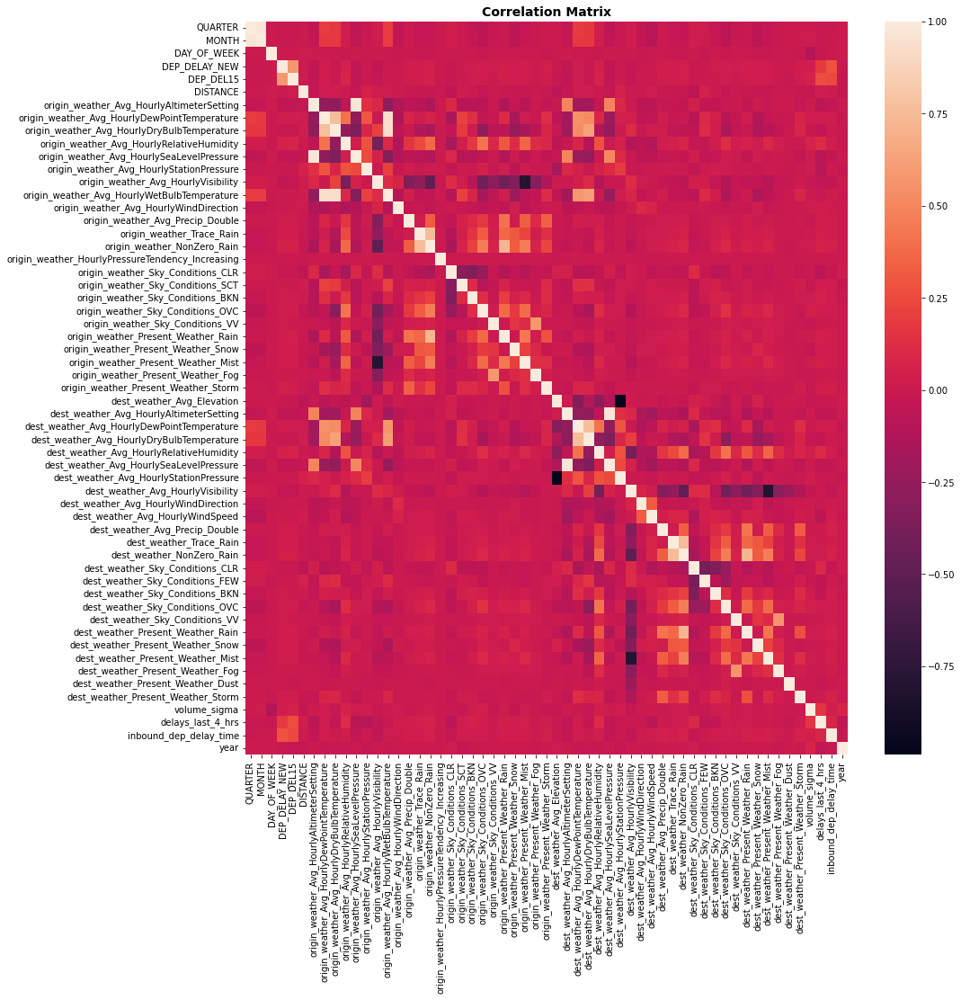

In [0]:
fig, ax = plt.subplots(figsize=(15, 15))
corr_plot = sns.heatmap(corrmatrix, yticklabels=columns, xticklabels=columns)
ax.set_title("Correlation Matrix", fontdict={"fontsize": 14, "fontweight": "bold"})

feature,correlation
origin_weather_Avg_HourlyAltimeterSetting,-0.038968674310134
dest_weather_Avg_HourlyAltimeterSetting,-0.0374251537628904
origin_weather_Avg_HourlySeaLevelPressure,-0.0366257700355149
origin_weather_Avg_HourlyVisibility,-0.03548775150524883
dest_weather_Avg_HourlySeaLevelPressure,-0.03504715368133548
dest_weather_Avg_HourlyVisibility,-0.03351688313355275
origin_weather_Sky_Conditions_CLR,-0.0121277808672565
dest_weather_Sky_Conditions_CLR,-0.009380953093526006
year,-0.008530038453442402
dest_weather_Avg_Elevation,-0.008200033068671937


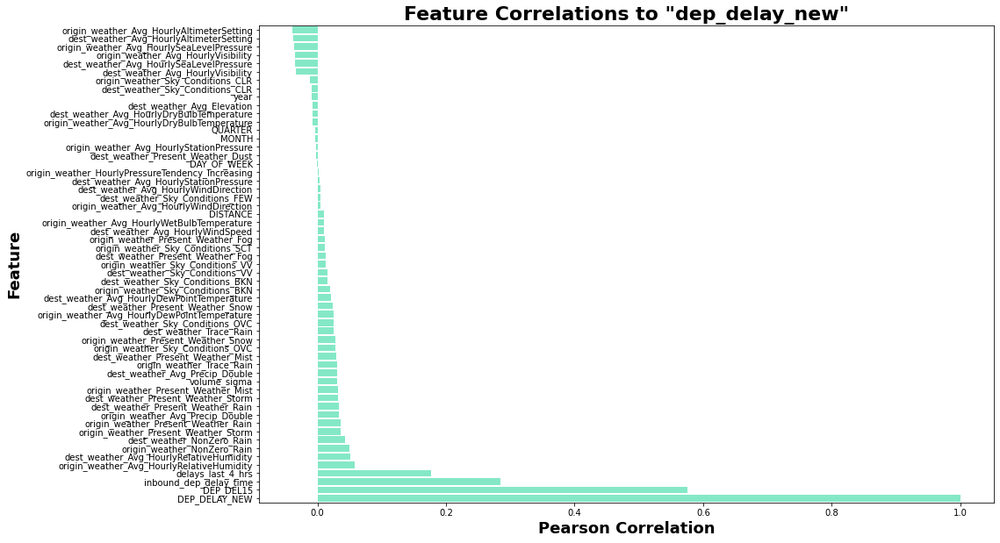

In [0]:
dep_delay_correlations = pd.DataFrame(
    list(zip(columns, corrmatrix[3])), columns=["feature", "correlation"]
)
dep_delay_correlations = dep_delay_correlations[
    ~dep_delay_correlations.feature.isin(
        ["dep_delay_new", "dep_delay", "dep_delay_group", "dep_del15"]
    )
]
dep_delay_correlations.sort_values(by="correlation", inplace=True)
fig, ax = plt.subplots(figsize=(15, 10))
sns.barplot(
    data=dep_delay_correlations, y="feature", x="correlation", color=FOREGROUND, ax=ax
)
ax.set_title(
    'Feature Correlations to "dep_delay_new"',
    fontdict={"fontsize": 22, "fontweight": "bold"},
)
ax.set_xlabel("Pearson Correlation", fontdict={"fontsize": 18, "fontweight": "bold"})
ax.set_ylabel("Feature", fontdict={"fontsize": 18, "fontweight": "bold"})
display(dep_delay_correlations)

feature,correlation
origin_weather_Avg_HourlyAltimeterSetting,-0.04870445900881351
origin_weather_Avg_HourlySeaLevelPressure,-0.04692438898787811
dest_weather_Avg_HourlyAltimeterSetting,-0.046252443236917115
dest_weather_Avg_HourlySeaLevelPressure,-0.04371903795108176
origin_weather_Avg_HourlyVisibility,-0.03336331787122451
year,-0.02906769988210865
dest_weather_Avg_HourlyVisibility,-0.028214575446292998
origin_weather_Sky_Conditions_CLR,-0.016245537750678746
dest_weather_Avg_Elevation,-0.013730542156409453
dest_weather_Avg_HourlyDryBulbTemperature,-0.00959680076541298


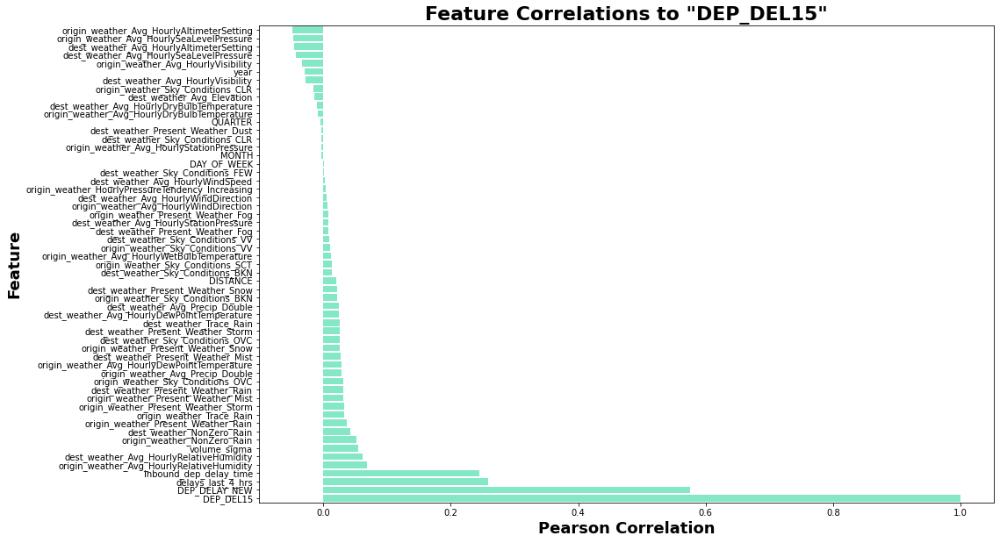

In [0]:
dep_delay_correlations = pd.DataFrame(
    list(zip(columns, corrmatrix[4])), columns=["feature", "correlation"]
)
dep_delay_correlations = dep_delay_correlations[
    ~dep_delay_correlations.feature.isin(
        ["dep_delay_new", "dep_delay", "dep_delay_group", "dep_del15"]
    )
]
dep_delay_correlations.sort_values(by="correlation", inplace=True)
fig, ax = plt.subplots(figsize=(15, 10))
sns.barplot(
    data=dep_delay_correlations, y="feature", x="correlation", color=FOREGROUND, ax=ax
)
ax.set_title(
    'Feature Correlations to "DEP_DEL15"',
    fontdict={"fontsize": 22, "fontweight": "bold"},
)
ax.set_xlabel("Pearson Correlation", fontdict={"fontsize": 18, "fontweight": "bold"})
ax.set_ylabel("Feature", fontdict={"fontsize": 18, "fontweight": "bold"})
display(dep_delay_correlations)

### Train-Test Split

In [0]:
# Split the joined data frame into year chunks to allow concatenating them as blocks as shown visually in the image above.
# The custom-cross validator is expecting a dictionary where each key is a different fold, and the key value is a dataframe with a column called 'cv' that designates rows
# As either train or split

series_folds = {
    "fold1": (["2015", "2016"], ["2017", "2018"]),
    "fold2": (["2015", "2016", "2017"], ["2018", "2019"]),
    "fold3": (["2015", "2016", "2017", "2018"], ["2019", "2020"]),
}
cross_validation_data = {}
for fold in series_folds.keys():
    train_years = series_folds[fold][0]
    val_years = series_folds[fold][1]
    cross_validation_data[fold] = (
        data.filter(data.year.isin(train_years + val_years))
        .withColumn(
            "cv", when(col("year").isin(train_years), "train").otherwise("test")
        )
        .cache()
    )

###Regression Models 

In the regression model based approach to delay 

In the case of regression the loss function for gradient descent during model training will be the Mean Square Error or MSE defined as: 

$$MSE = \frac{\sum_{i=1}^{n}{(y_i  -  \hat{y})^2}}{N} $$


**1. Naive Baseline**

Start off by simply predicting that the delay time is the average for that airport and month.

In [0]:
## Baseline

fl_date,day_of_week,crs_dep_time_utc,2hr_pre_dep,origin,dest,tail_num,dep_delay,dep_del15,dep_delay_new,flights,distance,distance_group,dep_delay_group,carrier_delay,weather_delay,nas_delay,security_delay,late_aircraft_delay,cancelled,tz,traffic,volume_sigma,delays_last_4_hrs,inbound_dep_delay_time,latitude,longitude,elevation,HourlyPrecipitation,HourlyStationPressure,HourlyVisibility,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,HourlyPressureChange,HourlyDewPointTemperature,HourlyWetBulbTemperature,HourlyDryBulbTemperature,thunderstorm,heavy_fog,hail,dust_storm,high_winds,freezing_rain,tornado
2015-09-30,3,2015-09-30T12:10:00.000+0000,2015-09-30T10:00:00,ECP,ATL,N919DE,-6.0,0.0,0.0,1.0,240.0,1,-1,null,null,null,null,null,0.0,America/Chicago,9,-0.32645842956368043,1.0,-2.0,30.349,-85.788,17.4,0.0,null,10.0,310.0,0.0,7.0,0.0,73.0,77.0,85.0,0,0,0,0,0,0,0
2018-04-06,5,2018-04-07T01:10:00.000+0000,2018-04-06T23:00:00,ECP,BNA,N7828A,-1.0,0.0,0.0,1.0,401.0,2,-1,null,null,null,null,null,0.0,America/Chicago,13,0.8381868093689805,0.0,-1.0,30.349,-85.788,17.4,0.0,null,9.0,170.0,0.0,6.0,0.0,67.0,68.0,69.0,0,0,0,0,0,0,0
2015-01-07,3,2015-01-07T15:42:00.000+0000,2015-01-07T13:00:00,EYW,MIA,N633MQ,-11.0,0.0,0.0,1.0,125.0,1,-1,null,null,null,null,null,0.0,America/New_York,2,-0.5983326430673354,0.0,-3.0,24.5571,-81.7554,0.3,0.0,0.07,9.94,340.0,0.0,14.0,0.07,68.0,70.0,75.0,0,0,0,0,0,0,0
2015-01-22,4,2015-01-22T19:25:00.000+0000,2015-01-22T17:00:00,EYW,MIA,N638MQ,-4.0,0.0,0.0,1.0,125.0,1,-1,null,null,null,null,null,0.0,America/New_York,3,-0.26719100459083056,0.0,-6.0,24.5571,-81.7554,0.3,0.0,null,10.0,100.0,24.0,16.0,0.0,70.0,72.0,75.0,0,0,0,0,0,0,0
2018-04-14,6,2018-04-14T15:55:00.000+0000,2018-04-14T13:00:00,EYW,DCA,N417YX,-10.0,0.0,0.0,1.0,1023.0,5,-1,null,null,null,null,null,0.0,America/New_York,8,1.3400485484883224,0.0,-9.0,24.5571,-81.7554,0.3,0.0,0.04,9.94,120.0,0.0,16.0,0.04,73.0,76.0,84.0,0,0,0,0,0,0,0
2018-04-25,3,2018-04-25T15:00:00.000+0000,2018-04-25T13:00:00,EYW,ATL,N758EV,-12.0,0.0,0.0,1.0,646.0,3,-1,null,null,null,null,null,0.0,America/New_York,6,0.6900249988484647,0.0,0.0,24.5571,-81.7554,0.3,0.0,0.04,9.94,0.0,0.0,7.0,0.04,69.0,73.0,82.0,0,0,0,0,0,0,0
2018-04-25,3,2018-04-25T15:55:00.000+0000,2018-04-25T13:00:00,EYW,DCA,N445YX,13.0,0.0,13.0,1.0,1023.0,5,0,null,null,null,null,null,0.0,America/New_York,6,0.6900249988484647,0.0,5.0,24.5571,-81.7554,0.3,0.0,0.04,9.94,0.0,0.0,7.0,0.04,69.0,73.0,82.0,0,0,0,0,0,0,0
2018-05-21,1,2018-05-21T21:15:00.000+0000,2018-05-21T19:00:00,EYW,CLT,N131HQ,18.0,1.0,18.0,1.0,736.0,3,1,null,null,null,null,null,0.0,America/New_York,3,-0.26719100459083056,1.0,-3.0,24.5571,-81.7554,0.3,0.0,-0.03,9.94,80.0,0.0,14.0,-0.03,72.0,72.0,72.0,0,0,0,0,0,0,0
2018-08-18,6,2018-08-18T18:37:00.000+0000,2018-08-18T16:00:00,EYW,ATL,N304DQ,-4.0,0.0,0.0,1.0,646.0,3,-1,null,null,null,null,null,0.0,America/New_York,4,0.04000144920860665,0.0,-2.0,24.5571,-81.7554,0.3,0.0,null,9.94,90.0,0.0,9.0,0.0,73.0,76.0,82.0,0,0,0,0,0,0,0
2018-12-28,5,2018-12-28T18:27:00.000+0000,2018-12-28T16:00:00,EYW,MIA,N428YX,-5.0,0.0,0.0,1.0,125.0,1,-1,null,null,null,null,null,0.0,America/New_York,10,2.050800464744703,0.0,-1.0,24.5571,-81.7554,0.3,0.0,0.01,7.46,110.0,0.0,11.0,0.01,74.0,76.0,81.0,0,0,0,0,0,0,0


A simplistic approach to the problem is calculating the mean of the delays (dep_delays). The mean delay is approximately equal to 13 minutes. However, this baseline does not capture the disparities of delays which fluctuates over airports and time. To better capture this phenomenon and keep a comprehensive baseline, the strategy is to calculate the mean delays grouped by the airport ("origin") and month (from "fl_date"). The ability of the baseline to capture delays disrparities is visible on the graph provided below.

Considering the cross-validation technic mentioned earlier, the baseline is calculated on each training fold. It yields to three mse that are averaged to get the performance of the Baseline.

Note, the average delay calculation is rounded to get rid of secondes as it is a reasonable approach to consider the "second" as a too-high granularity measure for travelers.

In [0]:
cross_validation_data["fold1"].filter(col("cv") == "train").agg(
    round(mean("DEP_DELAY_NEW")).alias("avg_delay")
).show()

+---------+
|avg_delay|
+---------+
|     12.0|
+---------+



In [0]:
group_cols = [month("FL_DATE"), "origin"]


def baseline(element_cross_validation_data, group_cols):
    return (
        element_cross_validation_data.filter(col("cv") == "train")
        .groupBy(group_cols)
        .agg(
            round(mean("DEP_DELAY_NEW")).alias("avg_delay"),
            concat_ws("_", month("FL_DATE"), "ORIGIN").alias("m_org_concat"),
        )
        .sort(desc("avg_delay"))
    )


fold1_agg = baseline(cross_validation_data["fold1"], group_cols)
fold2_agg = baseline(cross_validation_data["fold2"], group_cols)
fold3_agg = baseline(cross_validation_data["fold3"], group_cols)

# fold4_agg = baseline(cross_validation_data["fold4"], group_cols)

In [0]:
# to retrieve data in a dict
pandasDF = fold1_agg.toPandas()
avg_error_dict = dict(zip(pandasDF["m_org_concat"], pandasDF["avg_delay"]))
print(avg_error_dict)

{'12_GUC': 56.0, '2_UST': 52.0, '12_CIU': 50.0, '2_ILG': 45.0, '12_ASE': 45.0, '7_GCK': 40.0, '1_APN': 37.0, '2_TTN': 36.0, '12_EGE': 36.0, '3_MEI': 35.0, '3_BPT': 34.0, '1_CEC': 34.0, '11_BGM': 34.0, '12_BTM': 34.0, '9_STX': 34.0, '1_ILG': 33.0, '4_BPT': 32.0, '12_SPI': 32.0, '6_COU': 32.0, '5_GCK': 32.0, '2_SUX': 31.0, '7_HYA': 31.0, '7_MVY': 31.0, '12_BPT': 31.0, '5_UST': 31.0, '5_MEI': 31.0, '2_DVL': 30.0, '8_SAF': 30.0, '11_CIU': 30.0, '3_ILG': 30.0, '8_MVY': 30.0, '6_EYW': 29.0, '12_MFR': 29.0, '2_GRI': 29.0, '5_TYR': 29.0, '7_ITH': 29.0, '12_ESC': 29.0, '2_PLN': 28.0, '6_MVY': 28.0, '4_ILG': 28.0, '11_CMX': 28.0, '8_EAU': 28.0, '8_ORH': 28.0, '1_CMX': 28.0, '5_COU': 28.0, '2_BGR': 28.0, '4_PLN': 27.0, '2_DBQ': 27.0, '12_TWF': 27.0, '12_GGG': 27.0, '12_CMX': 27.0, '7_ORH': 27.0, '10_UST': 26.0, '12_CHO': 26.0, '7_EWR': 26.0, '12_BGR': 26.0, '10_ACK': 26.0, '8_ACY': 26.0, '1_JMS': 26.0, '8_OAJ': 26.0, '12_BGM': 26.0, '7_ERI': 25.0, '1_HIB': 25.0, '7_LGA': 25.0, '2_CMI': 25.0, '2_C

In [0]:
display(fold1_agg)

month(FL_DATE),origin,avg_delay,m_org_concat
12,GUC,56.0,12_GUC
2,UST,52.0,2_UST
12,CIU,50.0,12_CIU
12,ASE,45.0,12_ASE
2,ILG,45.0,2_ILG
7,GCK,40.0,7_GCK
1,APN,37.0,1_APN
2,TTN,36.0,2_TTN
12,EGE,36.0,12_EGE
3,MEI,35.0,3_MEI


Out[107]: array([[<AxesSubplot:title={'center':'avg_delay'}>]], dtype=object)

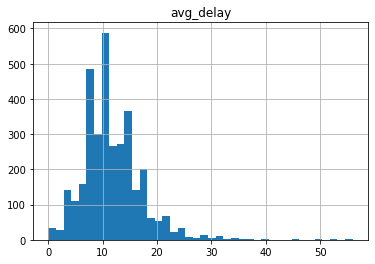

In [0]:
fold1_agg_viz = fold1_agg.toPandas()
fold1_agg_viz.hist(column="avg_delay", bins=40)

In [0]:
# mse of the baselines on the different folds:

In [0]:
# fold1
fold1_modified = (
    cross_validation_data["fold1"]
    .filter(col("cv") == "test")
    .withColumn("time_location", lit(concat_ws("_", month("fl_date"), "origin")))
)
joined = fold1_modified.join(
    fold1_agg, fold1_modified.time_location == fold1_agg.m_org_concat
)
fold1_mse = joined.withColumn(
    "error", (joined["DEP_DELAY_NEW"] - joined["avg_delay"]) ** 2
).agg(mean("error").alias("mse"))
fold1_mse.show()

+------------------+
|               mse|
+------------------+
|1869.9141275794414|
+------------------+



In [0]:
# fold2
fold2_modified = (
    cross_validation_data["fold2"]
    .filter(col("cv") == "test")
    .withColumn("time_location", lit(concat_ws("_", month("fl_date"), "origin")))
)
joined = fold2_modified.join(
    fold2_agg, fold2_modified.time_location == fold2_agg.m_org_concat
)
fold2_mse = joined.withColumn(
    "error", (joined["DEP_DELAY_NEW"] - joined["avg_delay"]) ** 2
).agg(mean("error").alias("mse"))
fold2_mse.show()

+-----------------+
|              mse|
+-----------------+
|2104.864097274619|
+-----------------+



In [0]:
# fold3
fold3_modified = (
    cross_validation_data["fold3"]
    .filter(col("cv") == "test")
    .withColumn("time_location", lit(concat_ws("_", month("fl_date"), "origin")))
)
joined = fold3_modified.join(
    fold3_agg, fold3_modified.time_location == fold3_agg.m_org_concat
)
fold3_mse = joined.withColumn(
    "error", (joined["DEP_DELAY_NEW"] - joined["avg_delay"]) ** 2
).agg(mean("error").alias("mse"))
fold3_mse.show()

+------------------+
|               mse|
+------------------+
|1897.3769682903614|
+------------------+



In [0]:
# fold4
"""
fold4_modified = cross_validation_data["fold4"].filter(col("cv") == "test").withColumn("time_location", lit(concat_ws("_", month("fl_date"), "origin")))
joined = fold4_modified.join(fold4_agg, fold4_modified.time_location == fold4_agg.m_org_concat )
fold4_mse = joined.withColumn("error", (joined["DEP_DELAY_NEW"]- joined["avg_delay"])**2).agg(mean("error").alias('mse'))
fold4_mse.show()
"""

Out[111]: '\nfold4_modified = cross_validation_data["fold4"].filter(col("cv") == "test").withColumn("time_location", lit(concat_ws("_", month("fl_date"), "origin")))\njoined = fold4_modified.join(fold4_agg, fold4_modified.time_location == fold4_agg.m_org_concat )\nfold4_mse = joined.withColumn("error", (joined["DEP_DELAY_NEW"]- joined["avg_delay"])**2).agg(mean("error").alias(\'mse\'))\nfold4_mse.show()\n'

The mse of this baseline is given by the average of the obtained mse(s) which is approximately equal to 1929 (minutes).
This baseline model is applied for inference on the test_data.

In [0]:
test_data = data.filter(year(col("fl_date")) == "2021")
display(test_data)

QUARTER,MONTH,DAY_OF_WEEK,FL_DATE,ORIGIN,DEP_DELAY_NEW,DEP_DEL15,DISTANCE,origin_weather_Avg_HourlyAltimeterSetting,origin_weather_Avg_HourlyDewPointTemperature,origin_weather_Avg_HourlyDryBulbTemperature,origin_weather_Avg_HourlyRelativeHumidity,origin_weather_Avg_HourlySeaLevelPressure,origin_weather_Avg_HourlyStationPressure,origin_weather_Avg_HourlyVisibility,origin_weather_Avg_HourlyWetBulbTemperature,origin_weather_Avg_HourlyWindDirection,origin_weather_Avg_Precip_Double,origin_weather_Trace_Rain,origin_weather_NonZero_Rain,origin_weather_HourlyPressureTendency_Increasing,origin_weather_Sky_Conditions_CLR,origin_weather_Sky_Conditions_SCT,origin_weather_Sky_Conditions_BKN,origin_weather_Sky_Conditions_OVC,origin_weather_Sky_Conditions_VV,origin_weather_Present_Weather_Rain,origin_weather_Present_Weather_Snow,origin_weather_Present_Weather_Mist,origin_weather_Present_Weather_Fog,origin_weather_Present_Weather_Storm,dest_weather_Avg_Elevation,dest_weather_Avg_HourlyAltimeterSetting,dest_weather_Avg_HourlyDewPointTemperature,dest_weather_Avg_HourlyDryBulbTemperature,dest_weather_Avg_HourlyRelativeHumidity,dest_weather_Avg_HourlySeaLevelPressure,dest_weather_Avg_HourlyStationPressure,dest_weather_Avg_HourlyVisibility,dest_weather_Avg_HourlyWindDirection,dest_weather_Avg_HourlyWindSpeed,dest_weather_Avg_Precip_Double,dest_weather_Trace_Rain,dest_weather_NonZero_Rain,dest_weather_Sky_Conditions_CLR,dest_weather_Sky_Conditions_FEW,dest_weather_Sky_Conditions_BKN,dest_weather_Sky_Conditions_OVC,dest_weather_Sky_Conditions_VV,dest_weather_Present_Weather_Rain,dest_weather_Present_Weather_Snow,dest_weather_Present_Weather_Mist,dest_weather_Present_Weather_Fog,dest_weather_Present_Weather_Dust,dest_weather_Present_Weather_Storm,volume_sigma,delays_last_4_hrs,inbound_dep_delay_time,year
1,1,5,2021-01-01,RDU,0.0,0.0,130.0,30.375,38.5,41.0,91.0,30.38,29.905,4.5,40.0,60.0,0.0,1,1,0,0,0,1,1,0,0,0,1,0,0,222.6,30.275,46.5,48.5,93.0,30.27,29.445,1.5,55.0,13.0,0.015,0,1,0,0,1,1,0,1,0,1,0,0,0,-0.9832034341048211,1.0,-5.0,2021
1,1,5,2021-01-01,SAT,0.0,0.0,1095.0,30.04,38.0,57.0,49.0,30.01,29.17,10.0,48.0,320.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,222.6,30.119999999999997,43.0,45.0,93.0,30.13,29.310000000000002,7.646666666666666,46.666666666666664,9.666666666666666,0.0033333333333333335,1,1,0,0,1,1,0,1,0,1,0,0,0,-1.5469197014945546,0.0,-4.0,2021
1,1,5,2021-01-01,CLT,0.0,0.0,600.0,30.13,41.0,43.0,93.0,30.12,29.309999999999995,9.588,42.0,14.0,0.022,0,1,1,0,1,1,1,0,1,0,0,0,0,8.2,30.13,67.0,75.0,76.0,30.12,30.1,10.0,180.0,6.0,0.0,0,0,1,0,0,0,0,0,0,0,0,0,0,-1.052501522149789,19.0,-6.0,2021
1,1,6,2021-01-02,RSW,0.0,0.0,600.0,30.11,67.0,81.0,62.0,30.1,30.08,10.0,72.0,200.0,0.0,0,0,1,0,1,0,0,0,0,0,0,0,0,222.6,30.026666666666667,52.0,54.5,91.75,30.02,29.215,9.235,230.0,7.0,0.0,0,0,0,0,1,0,0,0,0,0,0,0,0,2.0546440459520925,6.0,0.0,2021
1,1,6,2021-01-02,CLT,0.0,0.0,1095.0,30.0,53.0,59.0,81.0,30.0,29.205,9.969999999999999,56.0,180.0,0.0,0,0,1,0,0,0,1,0,0,0,0,0,0,243.6,30.14,26.0,62.0,25.0,30.11,29.27,10.0,230.0,9.0,0.0,0,0,1,0,0,0,0,0,0,0,0,0,0,0.09376731077921549,6.0,-1.0,2021
1,1,7,2021-01-03,SAT,0.0,0.0,1095.0,30.12,37.0,60.0,42.0,30.09,29.255000000000003,9.969999999999999,49.0,220.0,0.0,0,0,1,1,0,0,0,0,0,0,0,0,0,222.6,29.91,51.0,57.5,79.5,29.9,29.09,9.5,210.0,7.0,0.0,0,0,0,1,1,0,0,0,0,0,0,0,0,-0.728941871760167,3.0,-4.0,2021
1,1,7,2021-01-03,CLT,0.0,0.0,331.0,29.895,48.333333333333336,57.333333333333336,72.0,29.89,29.093333333333334,9.979999999999999,52.333333333333336,243.33333333333334,0.0,0,0,1,0,1,1,0,0,0,0,0,0,0,4.1,29.9375,38.6,41.0,91.4,29.94,29.870000000000005,4.946,328.0,10.8,0.016,0,1,0,0,1,1,0,1,0,1,0,0,0,0.5112355894385443,20.0,6.0,2021
1,1,7,2021-01-03,DCA,6.0,0.0,331.0,29.940000000000005,37.8,39.8,93.0,29.94,29.869999999999997,10.0,38.8,330.0,0.0,1,1,0,0,1,1,1,0,1,0,0,0,0,222.6,29.926666666666666,48.0,55.0,77.0,29.92,29.106666666666666,10.0,100.0,1.0,0.0,0,0,0,0,1,1,0,0,0,0,0,0,0,-1.3435193393186415,10.0,-4.0,2021
1,1,7,2021-01-03,CLT,0.0,0.0,33

In [0]:
test_modified = test_data.withColumn(
    "time_location", lit(concat_ws("_", month("fl_date"), "origin"))
)
joined = test_modified.join(
    fold3_agg, test_modified.time_location == fold3_agg.m_org_concat
)
test_mse = joined.withColumn(
    "error", (joined["DEP_DELAY_NEW"] - joined["avg_delay"]) ** 2
).agg(mean("error").alias("mse"))
test_mse.show()

+------------------+
|               mse|
+------------------+
|2135.9193471349236|
+------------------+



**2. Linear Regression**

As a simple baseline we will start with ordinary linear regression across a few different feature sets and hyper-parameters. Linear regression probably a poor fit for this type of prediction task but it will serve as a starting point for building future pipelines. The parameter maps we will explore are described below:

In [0]:
def parameter_combinations(parameter_dict):
    parameter_list = list(parameter_dict.keys())
    return (parameter_list, list(itertools.product(*parameter_dict.values())))

In [0]:
def linear_regression_pipeline(feature_columns, label_column, parameters):
    feature_vector_assembler = VectorAssembler(
        inputCols=feature_columns, outputCol="features"
    )
    data_scaler = MinMaxScaler(inputCol="features", outputCol="scaled_features")
    linear_regressor = LinearRegression(
        featuresCol="scaled_features",
        labelCol="DEP_DELAY_NEW",
        maxIter=parameters[0],
        regParam=parameters[1],
        elasticNetParam=parameters[2],
    )
    pipeline = Pipeline(
        stages=[feature_vector_assembler, data_scaler, linear_regressor]
    )
    return pipeline

In [0]:
def TimeSeriesCrossValidator(
    input_data, feature_columns, label_column, pipeline_type, parameter_combinations
):
    """Expects a dictionary where each key is a fold and value is a dataframe of training/test data with training/test rows identified by a column called 'cv'."""
    if pipeline_type == "linear_regression":
        print(f"Running {pipeline_type}")
        pipe_path = linear_regression_pipeline
    elif pipeline_type == "decision_tree_regression":
        print(f"Running {pipeline_type}")
        pipe_path = decision_tree_pipeline
    elif pipeline_type == "random_forest_regression":
        print(f"Running {pipeline_type}")
        pipe_path = random_forest_pipeline
    elif pipeline_type == "gradient_boosted_tree_regression":
        print(f"Running {pipeline_type}")
        pipe_path = gbTress_pipeline

    parameter_names = parameter_combinations[0]
    parameter_values = parameter_combinations[1]
    best_parameters = None
    lowest_loss = None

    for parameters in parameter_values:
        pipeline = pipe_path(feature_columns, label_column, parameters)
        fold_losses = []
        for fold in input_data.keys():
            train_data = input_data[fold].filter(col("cv") == "train")
            test_data = input_data[fold].filter(col("cv") == "test")
            model = pipeline.fit(train_data)

            predictions = model.transform(test_data)
            evaluator = RegressionEvaluator(labelCol=label_column)
            mse = evaluator.evaluate(predictions, {evaluator.metricName: "mse"})

            fold_losses.append(mse)
            print(f"{fold}: {mse}")

        mean_loss = np.mean(fold_losses)
        if not lowest_loss:
            lowest_loss = mean_loss

        if mean_loss <= lowest_loss:
            lowest_loss = mean_loss
            best_parameters = parameters
            parameter_string = {
                parameter_names[ii]: parameters[ii]
                for ii in range(len(parameter_names))
            }
            print(f"Lowest loss(mse): {lowest_loss}\nParmeters:{parameter_string}")
    return best_parameters, lowest_loss, lowest_loss**0.5

In [0]:
feature_columns = [
    "inbound_dep_delay_time",
    "delays_last_4_hrs",
    "origin_weather_Avg_HourlyRelativeHumidity",
    "origin_weather_NonZero_Rain",
    "origin_weather_Present_Weather_Storm",
    "origin_weather_Present_Weather_Rain",
    "origin_weather_Avg_Precip_Double",
    "origin_weather_Present_Weather_Mist",
    "volume_sigma",
    "origin_weather_Trace_Rain",
    "origin_weather_Sky_Conditions_OVC",
    "origin_weather_Present_Weather_Snow",
    "origin_weather_Avg_HourlyDewPointTemperature",
    "origin_weather_Sky_Conditions_BKN",
    "origin_weather_Sky_Conditions_VV",
    "origin_weather_Sky_Conditions_SCT",
    "origin_weather_Present_Weather_Fog",
    "origin_weather_Avg_HourlyAltimeterSetting",
    "origin_weather_Avg_HourlySeaLevelPressure",
    "origin_weather_Avg_HourlyVisibility",
    "origin_weather_Sky_Conditions_CLR",
]

# First create a parameter grid we want to explore for hyper-tunining the linear regression model.
lr_parameters = {
    "maxIter": [5, 10, 20],
    "regParam": [0, 0.01, 0.1],
    "elasticNetParam": [0, 1],
}
lr_param_combos = parameter_combinations(lr_parameters)
results = TimeSeriesCrossValidator(
    cross_validation_data,
    feature_columns,
    "DEP_DELAY_NEW",
    "linear_regression",
    lr_param_combos,
)
print(
    f"Linear Regresssion best params: {results[0]}, lowest loss(MSE): {results[1]}, lowest loss(RMSE): {results[2]}"
)

Running linear_regression
fold1: 1666.819476282915
fold2: 1896.2769783294032
fold3: 1729.540563317811
Lowest loss(mse): 1764.212339310043
Parmeters:{'maxIter': 5, 'regParam': 0, 'elasticNetParam': 0}
fold1: 1666.8194762829157
fold2: 1896.2769783294023
fold3: 1729.540563317811
Lowest loss(mse): 1764.2123393100428
Parmeters:{'maxIter': 5, 'regParam': 0, 'elasticNetParam': 1}
fold1: 1666.8112341810383
fold2: 1896.2642789963081
fold3: 1729.5283055653415
Lowest loss(mse): 1764.2012729142295
Parmeters:{'maxIter': 5, 'regParam': 0.01, 'elasticNetParam': 0}
fold1: 1666.8689659113338
fold2: 1896.2048643708517
fold3: 1729.3083284511833
Lowest loss(mse): 1764.1273862444561
Parmeters:{'maxIter': 5, 'regParam': 0.01, 'elasticNetParam': 1}
fold1: 1666.7392834407365
fold2: 1896.1530215884611
fold3: 1729.4194191801132
Lowest loss(mse): 1764.1039080697703
Parmeters:{'maxIter': 5, 'regParam': 0.1, 'elasticNetParam': 0}
fold1: 1666.5347890637563
fold2: 1895.5671301845139
fold3: 1728.846942189056
Lowest l

**3. Decision Tree**

In [0]:
# source: https://spark.apache.org/docs/latest/api/python/reference/api/pyspark.ml.regression.DecisionTreeRegressor.html
# https://spark.apache.org/docs/latest/ml-classification-regression.html#decision-tree-regression


def decision_tree_pipeline(feature_columns, label_column, parameters):

    feature_vector_assembler = VectorAssembler(
        inputCols=feature_columns, outputCol="features"
    )

    dt_regressor = DecisionTreeRegressor(
        featuresCol="features",
        labelCol="DEP_DELAY_NEW",
        maxDepth=parameters[0],
        maxBins=parameters[1],
    )
    pipeline = Pipeline(stages=[feature_vector_assembler, dt_regressor])
    return pipeline

In [0]:
feature_columns = [
    "inbound_dep_delay_time",
    "delays_last_4_hrs",
    "origin_weather_Avg_HourlyRelativeHumidity",
    "origin_weather_NonZero_Rain",
    "origin_weather_Present_Weather_Storm",
    "origin_weather_Present_Weather_Rain",
    "origin_weather_Avg_Precip_Double",
    "origin_weather_Present_Weather_Mist",
    "volume_sigma",
    "origin_weather_Trace_Rain",
    "origin_weather_Sky_Conditions_OVC",
    "origin_weather_Present_Weather_Snow",
    "origin_weather_Avg_HourlyDewPointTemperature",
    "origin_weather_Sky_Conditions_BKN",
    "origin_weather_Sky_Conditions_VV",
    "origin_weather_Sky_Conditions_SCT",
    "origin_weather_Present_Weather_Fog",
    "origin_weather_Avg_HourlyAltimeterSetting",
    "origin_weather_Avg_HourlySeaLevelPressure",
    "origin_weather_Avg_HourlyVisibility",
    "origin_weather_Sky_Conditions_CLR",
]

decision_tree_parameters = {"maxDepth": [5, 10, 15], "maxBins": [8, 16, 32]}
decision_tree_param_combos = parameter_combinations(decision_tree_parameters)
results = TimeSeriesCrossValidator(
    cross_validation_data,
    feature_columns,
    "DEP_DELAY_NEW",
    "decision_tree_regression",
    decision_tree_param_combos,
)

print(
    f"Decision Tree regression best params: {results[0]}, lowest loss(MSE): {results[1]}, lowest loss(RMSE): {results[2]}"
)

Running decision_tree_regression
fold1: 1676.7623517487837
fold2: 1903.700427554589
fold3: 1714.803571809042
Lowest loss(mse): 1765.0887837041382
Parmeters:{'maxDepth': 5, 'maxBins': 8}
fold1: 1639.3153801307762
fold2: 1860.0330686421244
fold3: 1684.0632241802577
Lowest loss(mse): 1727.803890984386
Parmeters:{'maxDepth': 5, 'maxBins': 16}
fold1: 1619.8642647021265
fold2: 1839.029936499218
fold3: 1669.2746391906696
Lowest loss(mse): 1709.3896134640047
Parmeters:{'maxDepth': 5, 'maxBins': 32}
fold1: 1674.3859272665313
fold2: 1900.3541931418667
fold3: 1707.665586550189
fold1: 1635.565520434221
fold2: 1851.7330674567586
fold3: 1674.8139976546552
fold1: 1612.8405993256356
fold2: 1834.6384473738951
fold3: 1660.770548048722
Lowest loss(mse): 1702.7498649160843
Parmeters:{'maxDepth': 10, 'maxBins': 32}
fold1: 1740.1018602839304
fold2: 1959.7854116065876
fold3: 1746.8546081941101
fold1: 1715.6902517157048
fold2: 1953.473240192276
fold3: 1732.175201314418
fold1: 1757.7552584914038
fold2: 1963.73

**4. Random Forest (regression tree)**

In [0]:
# source: https://spark.apache.org/docs/latest/api/python/reference/api/pyspark.ml.regression.RandomForestRegressor.html
def random_forest_pipeline(feature_columns, label_column, parameters):

    feature_vector_assembler = VectorAssembler(
        inputCols=feature_columns, outputCol="features"
    )

    rf_regressor = RandomForestRegressor(
        featuresCol="features",
        labelCol="DEP_DELAY_NEW",
        maxDepth=parameters[0],
        maxBins=parameters[1],
        numTrees=parameters[2],
    )
    pipeline = Pipeline(stages=[feature_vector_assembler, rf_regressor])
    return pipeline

In [0]:
feature_columns = [
    "inbound_dep_delay_time",
    "delays_last_4_hrs",
    "origin_weather_Avg_HourlyRelativeHumidity",
    "origin_weather_NonZero_Rain",
    "origin_weather_Present_Weather_Storm",
    "origin_weather_Present_Weather_Rain",
    "origin_weather_Avg_Precip_Double",
    "origin_weather_Present_Weather_Mist",
    "volume_sigma",
    "origin_weather_Trace_Rain",
    "origin_weather_Sky_Conditions_OVC",
    "origin_weather_Present_Weather_Snow",
    "origin_weather_Avg_HourlyDewPointTemperature",
    "origin_weather_Sky_Conditions_BKN",
    "origin_weather_Sky_Conditions_VV",
    "origin_weather_Sky_Conditions_SCT",
    "origin_weather_Present_Weather_Fog",
    "origin_weather_Avg_HourlyAltimeterSetting",
    "origin_weather_Avg_HourlySeaLevelPressure",
    "origin_weather_Avg_HourlyVisibility",
    "origin_weather_Sky_Conditions_CLR",
]

random_forest_parameters = {
    "maxDepth": [5, 10, 15],
    "maxBins": [8, 16, 32],
    "numTrees": [20, 60, 100],
}
random_forest_param_combos = parameter_combinations(random_forest_parameters)
results = TimeSeriesCrossValidator(
    cross_validation_data,
    feature_columns,
    "DEP_DELAY_NEW",
    "random_forest_regression",
    random_forest_param_combos,
)

print(
    f"Random Forest regression best params: {results[0]}, lowest loss(MSE): {results[1]}, lowest loss(RMSE): {results[2]}"
)

Running random_forest_regression
fold1: 1688.854613861371
fold2: 1913.4445601677473
fold3: 1730.2072254225045
Lowest loss(mse): 1777.5021331505407
Parmeters:{'maxDepth': 5, 'maxBins': 8, 'numTrees': 20}
fold1: 1688.4516237771054
fold2: 1912.866166034337
fold3: 1728.4250650089148
Lowest loss(mse): 1776.5809516067857
Parmeters:{'maxDepth': 5, 'maxBins': 8, 'numTrees': 60}
fold1: 1689.149681665988
fold2: 1912.9391090309948
fold3: 1728.5625995815249
fold1: 1653.9646701729
fold2: 1876.950664578215
fold3: 1704.1538286979528
Lowest loss(mse): 1745.0230544830226
Parmeters:{'maxDepth': 5, 'maxBins': 16, 'numTrees': 20}
fold1: 1652.7302361868055
fold2: 1875.1479550473298
fold3: 1700.3354972882578
Lowest loss(mse): 1742.7378961741313
Parmeters:{'maxDepth': 5, 'maxBins': 16, 'numTrees': 60}
fold1: 1654.681903649593
fold2: 1875.5414101663873
fold3: 1702.085132481577
fold1: 1640.1713960233749
fold2: 1861.5341137499436
fold3: 1691.442332058233
Lowest loss(mse): 1731.049280610517
Parmeters:{'maxDepth'

**5. Gradient Boosted Trees**

In [0]:
def gbTress_pipeline(feature_columns, label_column, parameters):

    feature_vector_assembler = VectorAssembler(
        inputCols=feature_columns, outputCol="features"
    )

    gbt_regressor = GBTRegressor(
        featuresCol="features",
        labelCol="DEP_DELAY_NEW",
        maxDepth=parameters[0],
        maxBins=parameters[1],
        maxIter=parameters[2],
    )
    pipeline = Pipeline(stages=[feature_vector_assembler, gbt_regressor])
    return pipeline

In [0]:
feature_columns = [
    "inbound_dep_delay_time",
    "delays_last_4_hrs",
    "origin_weather_Avg_HourlyRelativeHumidity",
    "origin_weather_NonZero_Rain",
    "origin_weather_Present_Weather_Storm",
    "origin_weather_Present_Weather_Rain",
    "origin_weather_Avg_Precip_Double",
    "origin_weather_Present_Weather_Mist",
    "volume_sigma",
    "origin_weather_Trace_Rain",
    "origin_weather_Sky_Conditions_OVC",
    "origin_weather_Present_Weather_Snow",
    "origin_weather_Avg_HourlyDewPointTemperature",
    "origin_weather_Sky_Conditions_BKN",
    "origin_weather_Sky_Conditions_VV",
    "origin_weather_Sky_Conditions_SCT",
    "origin_weather_Present_Weather_Fog",
    "origin_weather_Avg_HourlyAltimeterSetting",
    "origin_weather_Avg_HourlySeaLevelPressure",
    "origin_weather_Avg_HourlyVisibility",
    "origin_weather_Sky_Conditions_CLR",
]

gbTress_parameters = {
    "maxDepth": [5, 10, 15],
    "maxBins": [8, 16, 32],
    "maxIter": [10, 50, 100],
}

gbt_param_combos = parameter_combinations(gbTress_parameters)
results = TimeSeriesCrossValidator(
    cross_validation_data,
    feature_columns,
    "DEP_DELAY_NEW",
    "gradient_boosted_tree_regression",
    gbt_param_combos,
)
print(
    f"Gradient Boosted Tree regression best params: {results[0]}, lowest loss(MSE): {results[1]}, lowest loss(RMSE): {results[2]}"
)

Running gradient_boosted_tree_regression
fold1: 1669.221088985191
fold2: 1897.2288397766995
fold3: 1708.5107604704597
Lowest loss(mse): 1758.3202297441167
Parmeters:{'maxDepth': 5, 'maxBins': 8, 'maxIter': 10}
fold1: 1665.9599059228715
fold2: 1893.2691360922863
fold3: 1704.8100693926626
Lowest loss(mse): 1754.6797038026068
Parmeters:{'maxDepth': 5, 'maxBins': 8, 'maxIter': 50}
fold1: 1665.0032617875177
fold2: 1892.1439393643302
fold3: 1703.8715567323377
Lowest loss(mse): 1753.6729192947287
Parmeters:{'maxDepth': 5, 'maxBins': 8, 'maxIter': 100}
fold1: 1627.044741680705
fold2: 1849.8258144093081
fold3: 1676.8257967618085
Lowest loss(mse): 1717.8987842839406
Parmeters:{'maxDepth': 5, 'maxBins': 16, 'maxIter': 10}
fold1: 1622.726526366066
fold2: 1843.7747913788342
fold3: 1671.281716319053
Lowest loss(mse): 1712.5943446879844
Parmeters:{'maxDepth': 5, 'maxBins': 16, 'maxIter': 50}
fold1: 1622.1012366524185
fold2: 1843.3987642954137
fold3: 1670.00273403345
Lowest loss(mse): 1711.83424499376

### Regression Model Evaluation on Test Dataset

In [0]:
def evaluate_testSet(
    train_data, test_data, feature_columns, label_column, model_type, parameters
):
    """This function would evaluate the test data using the best parameters obtained from
    the time series cross validation.
    """
    print(f"Begin fitting pipeline on train dataset to create {model_type} model")
    if model_type == "linear_regression":
        pipeline = linear_regression_pipeline(feature_columns, label_column, parameters)

    elif model_type == "decision_tree_regression":
        pipeline = decision_tree_pipeline(feature_columns, label_column, parameters)

    elif model_type == "random_forest_regression":
        pipeline = random_forest_pipeline(feature_columns, label_column, parameters)

    elif model_type == "gradient_boosted_tree_regression":
        pipeline = gbTress_pipeline(feature_columns, label_column, parameters)

    model = pipeline.fit(train_data)
    print(
        "pipeline fit has been completed on the train data! Let's begin model transformation on the test data."
    )
    predictions = model.transform(test_data)

    print("Model transformation on test data completed! Now begin evaluation.")
    evaluator = RegressionEvaluator(labelCol=label_column)
    rmse = evaluator.evaluate(predictions, {evaluator.metricName: "rmse"})
    mse = evaluator.evaluate(predictions, {evaluator.metricName: "mse"})
    r_squared = evaluator.evaluate(predictions, {evaluator.metricName: "r2"})
    print("Evaluation completed!")
    print(f"Evaluation results for {model_type} are: ")
    print(f"RMSE: {rmse}, MSE: {mse}, R-SQUARED: {r_squared}")
    return model


# Run evaluation function. Remember to specify the model_type
feature_columns = [
    "inbound_dep_delay_time",
    "delays_last_4_hrs",
    "origin_weather_Avg_HourlyRelativeHumidity",
    "origin_weather_NonZero_Rain",
    "origin_weather_Present_Weather_Storm",
    "origin_weather_Present_Weather_Rain",
    "origin_weather_Avg_Precip_Double",
    "origin_weather_Present_Weather_Mist",
    "volume_sigma",
    "origin_weather_Trace_Rain",
    "origin_weather_Sky_Conditions_OVC",
    "origin_weather_Present_Weather_Snow",
    "origin_weather_Avg_HourlyDewPointTemperature",
    "origin_weather_Sky_Conditions_BKN",
    "origin_weather_Sky_Conditions_VV",
    "origin_weather_Sky_Conditions_SCT",
    "origin_weather_Present_Weather_Fog",
    "origin_weather_Avg_HourlyAltimeterSetting",
    "origin_weather_Avg_HourlySeaLevelPressure",
    "origin_weather_Avg_HourlyVisibility",
    "origin_weather_Sky_Conditions_CLR",
]

label_column = "DEP_DELAY_NEW"
parameters = list(results[0])

train_data = data.filter((col("year")) < "2021")
test_data = data.filter((col("year")) == "2021")
model_type = "gradient_boosted_tree_regression"

evaluate_testSet(
    train_data, test_data, feature_columns, label_column, model_type, parameters
)

Begin fitting pipeline on train dataset to create gradient_boosted_tree_regression model


## Results and Discusion of Results

<img src="https://github.com/YemiOlani/w261_images/blob/main/results_table.JPG?raw=true" width=40%>

The featutres used for the regression task were obtained from the correlation matrix calculated above. Although all the feaures show very weak corrleation, we however still was able to obtain some of the more correlated features and used for training and evaluation purposes. The features used were day_of_week, distance, dep_delay_group, traffic,volume_sigma, delays_last_4_hrs, inbound_dep_delay_time, HourlyVisibility, latitude, longitude, HourlyWindDirection,HourlyWindSpeed,HourlyPressureChange,HourlyDryBulbTemperature, thunderstorm, heavy_fog, hail, dust_storm, month. 

Linear regression (OLS, Ridge, Lasso), decision tree and random forest were explored for the training and inference using time series K-fold cross validation. Xgboost couldn't be explored due to error and time constraint in fixing the error. The help of the infracstructure instructor might be needed to fix the issue.

The result obtained from the training and testing is shown in the screen shot above. Our result showed random forest to have the lowest mean squared/root mean squared error loss, however it is just 1 point below decision tree. If we compare the training and inference time of the decision tree and the random forest, we can trade-off the training and inference time for the 1 point lower, hence decision tree is regarded to have the best performance in our experiment.